Copyright © The University of Edinburgh, 2024.

Development has been supported by GSK.

# Visualization of split-averaged PR curves 

## All CMAP filtered compounds

### Single line plots
Representing the "merged splits" percent replicating scores present in the SI of the Leak Proof CMAP Manuscript

,similarity metric,percent replicating
0,TripletLoss,54.809
1,Rank,37.227
2,Zhang,36.620
3,Cosine,35.676
4,Euclidean,12.604
5,EuclideanPCA,11.383


,similarity metric,percent replicating
0,TripletLoss,24.663
1,Rank,12.742
2,Zhang,11.199
3,Cosine,10.411
4,Euclidean,8.637
5,EuclideanPCA,5.846


,similarity metric,percent replicating
0,TripletLoss,67.587
1,Rank,77.521
2,Zhang,76.794
3,Cosine,85.273
4,Euclidean,28.073
5,EuclideanPCA,27.873


,similarity metric,percent replicating
0,TripletLoss,19.619
1,Rank,9.905
2,Zhang,9.238
3,Cosine,8.762
4,Euclidean,7.714
5,EuclideanPCA,4.762


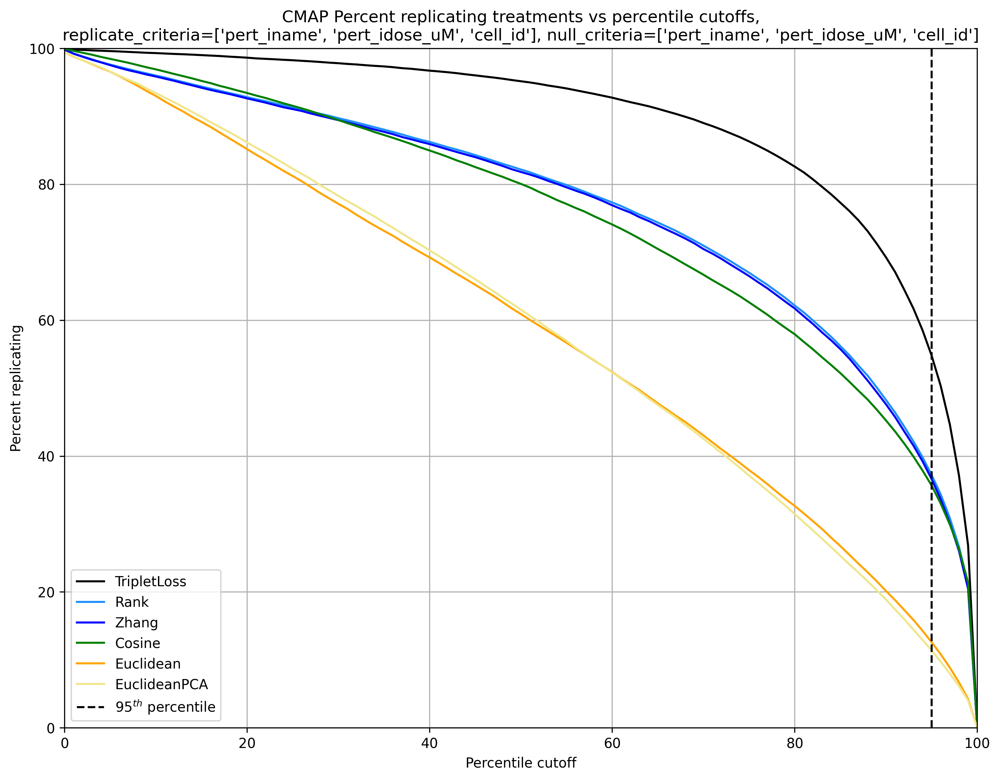

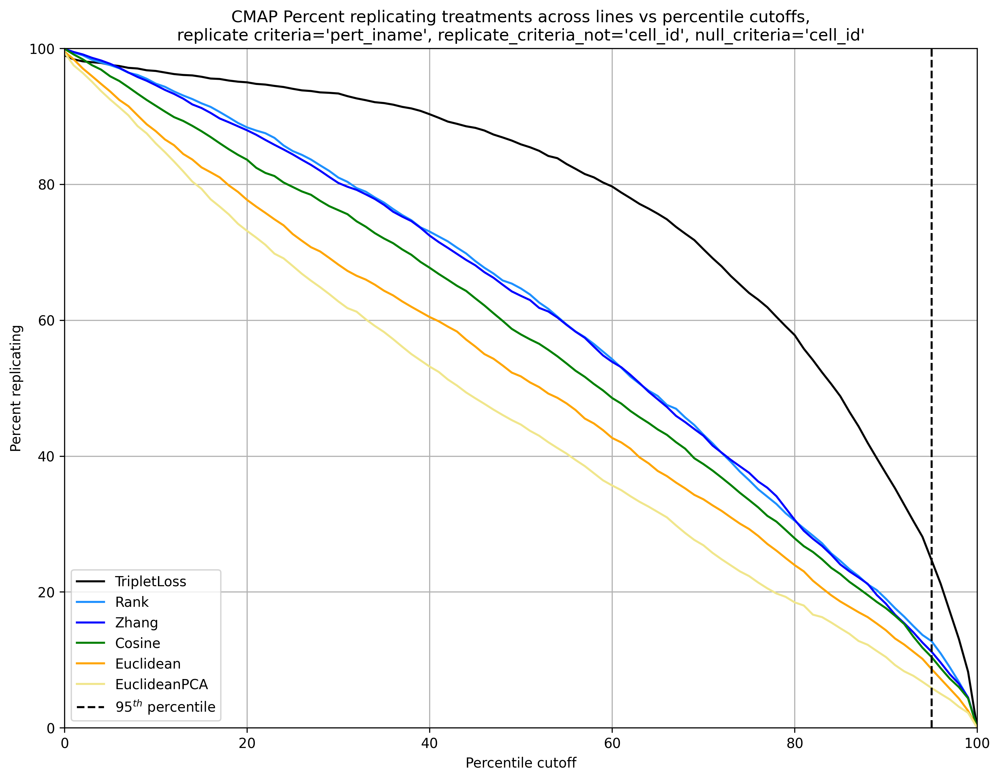

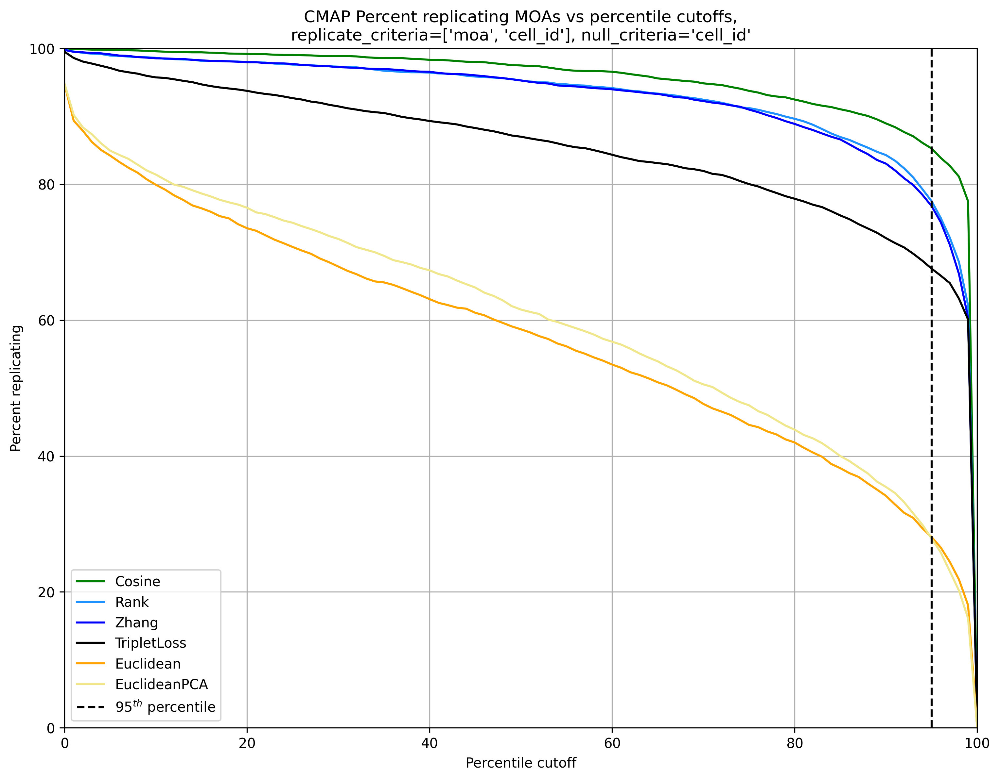

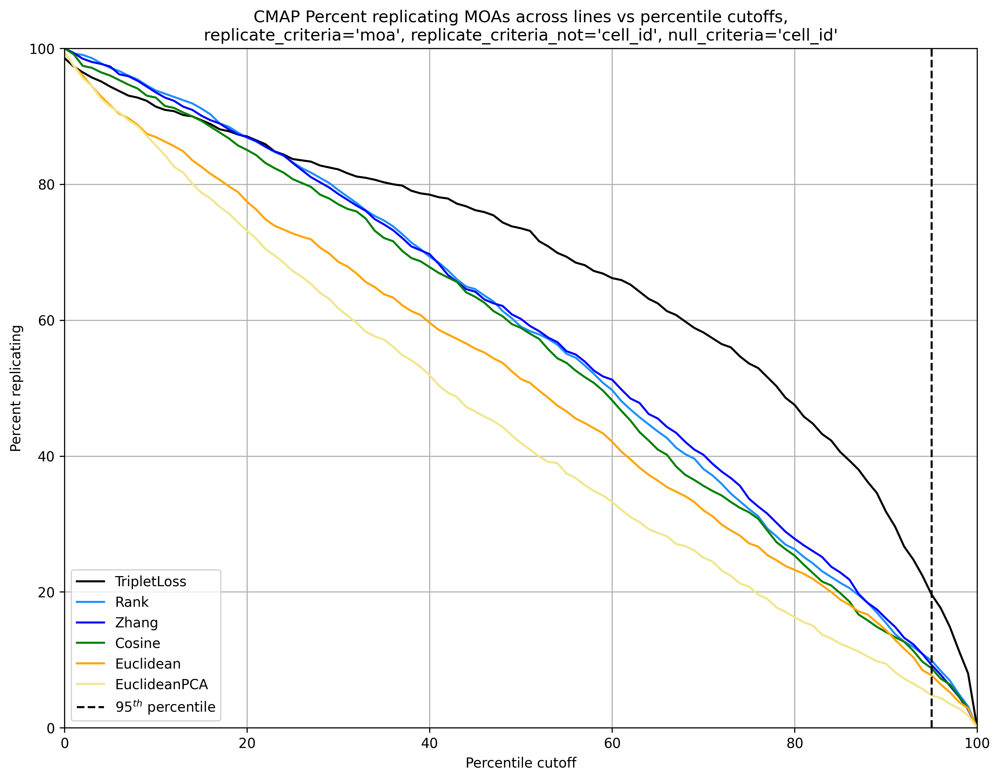

In [9]:
# Plot PR CMAP
import seaborn as sns
from pathlib import Path
import pandas as pd
from matplotlib import pyplot as plt

import leakproofcmap
from leakproofcmap.data_wrangling import postprocess_pr_files
plt.rcParams['savefig.facecolor']='white'
SEED=7
MODEL_NAME="TripletLoss"
MODEL_IDENTIFIER="155"
CELL_LINE_SPLIT=1
PERTURBATION_SPLIT=1
working_dir=Path("working_dir")
checkpoint_dir=working_dir/Path(MODEL_NAME)/Path("trained")/Path(MODEL_IDENTIFIER)/Path("checkpoints")
metric_display_order_in_tables=['TripletLoss', 'Rank', 'Zhang', 'Cosine', 'Euclidean', 'EuclideanPCA']

pr_visualisations=[
    {
        'pr_type':'compactness',
        'raw_plot_data':working_dir/Path("plot_data")/Path(MODEL_NAME)/Path(MODEL_IDENTIFIER)/Path("compactness")/Path(f"plot_compactness_cutoffs_cmap_seed_{SEED}.csv"),
        'plot_title':f"CMAP Percent replicating treatments vs percentile cutoffs,\nreplicate_criteria=['pert_iname', 'pert_idose_uM', 'cell_id'], null_criteria=['pert_iname', 'pert_idose_uM', 'cell_id']"
    },
    {
        'pr_type':'compactness_across_lines',
        'raw_plot_data':working_dir/Path("plot_data")/Path(MODEL_NAME)/Path(MODEL_IDENTIFIER)/Path("compactness_across_lines")/Path(f"plot_compactness_cutoffs_cmap_across_lines_seed_{SEED}.csv"),
        'plot_title':f"CMAP Percent replicating treatments across lines vs percentile cutoffs,\nreplicate criteria='pert_iname', replicate_criteria_not='cell_id', null_criteria='cell_id'"
    },
    {
        'pr_type':'compactness_moas',
        'raw_plot_data':working_dir/Path("plot_data")/Path(MODEL_NAME)/Path(MODEL_IDENTIFIER)/Path("compactness_moas")/Path(f"plot_compactness_cutoffs_cmap_moas_seed_{SEED}.csv"),
        'plot_title':f"CMAP Percent replicating MOAs vs percentile cutoffs,\nreplicate_criteria=['moa', 'cell_id'], null_criteria='cell_id'"
    },
    {
        'pr_type':'compactness_across_lines_moas',
        'raw_plot_data':working_dir/Path("plot_data")/Path(MODEL_NAME)/Path(MODEL_IDENTIFIER)/Path("compactness_across_lines_moas")/Path(f"plot_compactness_cutoffs_cmap_across_lines_moas_seed_{SEED}.csv"),
        'plot_title':f"CMAP Percent replicating MOAs across lines vs percentile cutoffs,\nreplicate_criteria='moa', replicate_criteria_not='cell_id', null_criteria='cell_id'"
    },
]

for pr_visualisation in pr_visualisations:
    if not pr_visualisation['raw_plot_data'].exists():
        print("Not found", pr_visualisation['raw_plot_data'])
        postprocess_pr_files(seed=SEED,model_name=MODEL_NAME, model_identifier=MODEL_IDENTIFIER, restrict_pr_type=pr_visualisation['pr_type'])
    plot_df=pd.read_csv(pr_visualisation['raw_plot_data'])
    ranked_metric_list=[m for m in plot_df.query("`cutoff percentile` == 95").sort_values("percent replicating", ascending=False)['similarity metric'].tolist()]

    fig, ax=plt.subplots(1,figsize=(12,9), dpi=300)
    for rmn in ranked_metric_list:
        sns.lineplot(plot_df.query("`similarity metric` == @rmn"), x="cutoff percentile", y='percent replicating',  hue='similarity metric', ax=ax, sort=False,palette=leakproofcmap.palette)
    
    ax.grid()
    ax.axvline(95, 0,100, linestyle='--', color='k', label=r'$95^{th}$ percentile')
    ax.set_xlim(0,100)
    ax.set_ylim(0,100)
    ax.set_xlabel("Percentile cutoff")
    ax.set_ylabel("Percent replicating")
    ax.set_title(pr_visualisation['plot_title'])
    ax.legend()
    fig.show()

    metric_pr_score_df=plot_df.query("`cutoff percentile`==95").reset_index()[['similarity metric', 'percent replicating']].sort_values('percent replicating', ascending=False).set_index("similarity metric").loc[metric_display_order_in_tables].reset_index()
    
    display(metric_pr_score_df.round(3))
    metric_pr_score_df.to_csv(str(pr_visualisation['raw_plot_data'].with_suffix(""))+"_95pctl.csv")
    fig.savefig(pr_visualisation['raw_plot_data'].with_suffix(".svg"),pad_inches=0, bbox_inches='tight')
    fig.savefig(pr_visualisation['raw_plot_data'].with_suffix(".png"),pad_inches=0, bbox_inches='tight')



### Plots with split differences shown as seaborn bands

['TripletLoss', 'Rank', 'Zhang', 'Cosine', 'Euclidean', 'EuclideanPCA']
kruskal: KruskalResult(statistic=122.38990840432942, pvalue=9.781545489037361e-25)


/home/ss942793/.conda/envs/leakproofcmap/lib/python3.10/site-packages/scipy/stats/_morestats.py:4088: UserWarning: Exact p-value calculation does not work if there are zeros. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/home/ss942793/.conda/envs/leakproofcmap/lib/python3.10/site-packages/scipy/stats/_morestats.py:4088: UserWarning: Exact p-value calculation does not work if there are zeros. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/home/ss942793/.conda/envs/leakproofcmap/lib/python3.10/site-packages/scipy/stats/_morestats.py:4088: UserWarning: Exact p-value calculation does not work if there are zeros. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/home/ss942793/.conda/envs/leakproofcmap/lib/python3.10/site-packages/scipy/stats/_morestats.py:4088: UserWarning: Exact p-value calculation does not work

'Wilcoxon test-derived pvalues:'

,TripletLoss,Rank,Zhang,Cosine,Euclidean,EuclideanPCA
TripletLoss,NaN,8.940697e-08,5.960464e-08,2.980232e-08,2.980232e-08,2.980232e-08
Rank,1.0,NaN,1.350797e-05,6.777346e-03,2.980232e-08,2.980232e-08
Zhang,1.0,9.999865e-01,NaN,1.375921e-01,2.980232e-08,2.980232e-08
Cosine,1.0,9.937668e-01,8.682619e-01,NaN,2.980232e-08,2.980232e-08
Euclidean,1.0,1.000000e+00,1.000000e+00,1.000000e+00,NaN,1.591086e-04
EuclideanPCA,1.0,1.000000e+00,1.000000e+00,1.000000e+00,9.998409e-01,NaN


'FDR-corrected Wilcoxon test-derived pvalues:'

,TripletLoss,Rank,Zhang,Cosine,Euclidean,EuclideanPCA
TripletLoss,NaN,2.438372e-07,1.788139e-07,9.934107e-08,9.934107e-08,9.934107e-08
Rank,1.0,NaN,3.376994e-05,1.452288e-02,9.934107e-08,9.934107e-08
Zhang,1.0,1.000000e+00,NaN,2.751843e-01,9.934107e-08,9.934107e-08
Cosine,1.0,1.000000e+00,1.000000e+00,NaN,9.934107e-08,9.934107e-08
Euclidean,1.0,1.000000e+00,1.000000e+00,1.000000e+00,NaN,3.671737e-04
EuclideanPCA,1.0,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,NaN


'Merged splits'

percent replicating       
                                 mean    std
similarity metric                           
TripletLoss                    55.217  7.859
Rank                           37.930  5.628
Zhang                          37.319  5.698
Cosine                         35.913  3.274
Euclidean                      12.571  1.111
EuclideanPCA                   11.441  1.235

['TripletLoss', 'Rank', 'Zhang', 'Cosine', 'Euclidean', 'EuclideanPCA']
kruskal: KruskalResult(statistic=12.753691264902143, pvalue=0.02579959022406216)


/home/ss942793/.conda/envs/leakproofcmap/lib/python3.10/site-packages/scipy/stats/_morestats.py:4088: UserWarning: Exact p-value calculation does not work if there are zeros. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/home/ss942793/.conda/envs/leakproofcmap/lib/python3.10/site-packages/scipy/stats/_morestats.py:4088: UserWarning: Exact p-value calculation does not work if there are zeros. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/home/ss942793/.conda/envs/leakproofcmap/lib/python3.10/site-packages/scipy/stats/_morestats.py:4088: UserWarning: Exact p-value calculation does not work if there are zeros. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/home/ss942793/.conda/envs/leakproofcmap/lib/python3.10/site-packages/scipy/stats/_morestats.py:4088: UserWarning: Exact p-value calculation does not work

'Wilcoxon test-derived pvalues:'

,TripletLoss,Rank,Zhang,Cosine,Euclidean,EuclideanPCA
TripletLoss,NaN,0.003395,0.005959,0.000599,0.003720,0.004452
Rank,0.996605,NaN,0.157763,0.002570,0.018502,0.018341
Zhang,0.994041,0.842237,NaN,0.044149,0.145603,0.045158
Cosine,0.999401,0.997430,0.955851,NaN,0.650153,0.253852
Euclidean,0.996280,0.981498,0.854397,0.349847,NaN,0.079581
EuclideanPCA,0.995548,0.984096,0.957430,0.762918,0.920419,NaN


'FDR-corrected Wilcoxon test-derived pvalues:'

,TripletLoss,Rank,Zhang,Cosine,Euclidean,EuclideanPCA
TripletLoss,NaN,0.026715,0.029797,0.017957,0.026715,0.026715
Rank,0.999401,NaN,0.364069,0.026715,0.069383,0.069383
Zhang,0.999401,0.999401,NaN,0.135474,0.364007,0.135474
Cosine,0.999401,0.999401,0.999401,NaN,0.999401,0.543969
Euclidean,0.999401,0.999401,0.999401,0.699694,NaN,0.217038
EuclideanPCA,0.999401,0.999401,0.999401,0.999401,0.999401,NaN


'Merged splits'

percent replicating        
                                 mean     std
similarity metric                            
TripletLoss                    26.771  26.306
Rank                           16.322  11.195
Zhang                          15.039  10.816
Cosine                         11.679   9.100
Euclidean                      13.175   9.937
EuclideanPCA                   10.214   8.516

['TripletLoss', 'Rank', 'Zhang', 'Cosine', 'Euclidean', 'EuclideanPCA']
kruskal: KruskalResult(statistic=120.98802437112089, pvalue=1.9383857229416346e-24)


/home/ss942793/.conda/envs/leakproofcmap/lib/python3.10/site-packages/scipy/stats/_morestats.py:4088: UserWarning: Exact p-value calculation does not work if there are zeros. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/home/ss942793/.conda/envs/leakproofcmap/lib/python3.10/site-packages/scipy/stats/_morestats.py:4088: UserWarning: Exact p-value calculation does not work if there are zeros. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/home/ss942793/.conda/envs/leakproofcmap/lib/python3.10/site-packages/scipy/stats/_morestats.py:4088: UserWarning: Exact p-value calculation does not work if there are zeros. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/home/ss942793/.conda/envs/leakproofcmap/lib/python3.10/site-packages/scipy/stats/_morestats.py:4088: UserWarning: Exact p-value calculation does not work

'Wilcoxon test-derived pvalues:'

,TripletLoss,Rank,Zhang,Cosine,Euclidean,EuclideanPCA
TripletLoss,NaN,1.000000,0.999995,1.000000,2.980232e-08,2.980232e-08
Rank,4.172325e-07,NaN,0.165207,0.999964,2.980232e-08,2.980232e-08
Zhang,6.169081e-06,0.834793,NaN,0.999997,2.980232e-08,2.980232e-08
Cosine,2.980232e-08,0.000036,0.000004,NaN,2.980232e-08,2.980232e-08
Euclidean,1.000000e+00,1.000000,1.000000,1.000000,NaN,3.025592e-01
EuclideanPCA,1.000000e+00,1.000000,1.000000,1.000000,6.974408e-01,NaN


'FDR-corrected Wilcoxon test-derived pvalues:'

,TripletLoss,Rank,Zhang,Cosine,Euclidean,EuclideanPCA
TripletLoss,NaN,1.000000,1.000000,1.0,9.934107e-08,9.934107e-08
Rank,1.251698e-06,NaN,0.354016,1.0,9.934107e-08,9.934107e-08
Zhang,1.542270e-05,1.000000,NaN,1.0,9.934107e-08,9.934107e-08
Cosine,9.934107e-08,0.000082,0.000011,NaN,9.934107e-08,9.934107e-08
Euclidean,1.000000e+00,1.000000,1.000000,1.0,NaN,6.051183e-01
EuclideanPCA,1.000000e+00,1.000000,1.000000,1.0,1.000000e+00,NaN


'Merged splits'

percent replicating       
                                 mean    std
similarity metric                           
TripletLoss                    66.804  7.935
Rank                           77.209  5.766
Zhang                          76.549  6.280
Cosine                         84.472  4.999
Euclidean                      27.912  4.539
EuclideanPCA                   27.566  4.020

['TripletLoss', 'Rank', 'Zhang', 'Cosine', 'Euclidean', 'EuclideanPCA']
kruskal: KruskalResult(statistic=6.488950990645253, pvalue=0.2615039763517176)


/home/ss942793/.conda/envs/leakproofcmap/lib/python3.10/site-packages/scipy/stats/_morestats.py:4088: UserWarning: Exact p-value calculation does not work if there are zeros. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/home/ss942793/.conda/envs/leakproofcmap/lib/python3.10/site-packages/scipy/stats/_morestats.py:4088: UserWarning: Exact p-value calculation does not work if there are zeros. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/home/ss942793/.conda/envs/leakproofcmap/lib/python3.10/site-packages/scipy/stats/_morestats.py:4088: UserWarning: Exact p-value calculation does not work if there are zeros. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/home/ss942793/.conda/envs/leakproofcmap/lib/python3.10/site-packages/scipy/stats/_morestats.py:4088: UserWarning: Exact p-value calculation does not work

'Wilcoxon test-derived pvalues:'

,TripletLoss,Rank,Zhang,Cosine,Euclidean,EuclideanPCA
TripletLoss,NaN,0.044652,0.033965,0.010901,0.041201,0.017925
Rank,0.955348,NaN,0.180013,0.091979,0.136733,0.034508
Zhang,0.966035,0.819987,NaN,0.116207,0.454745,0.188741
Cosine,0.989099,0.908021,0.883793,NaN,0.663548,0.228047
Euclidean,0.958799,0.863267,0.545255,0.336452,NaN,0.079474
EuclideanPCA,0.982075,0.965492,0.811259,0.771953,0.920526,NaN


'FDR-corrected Wilcoxon test-derived pvalues:'

,TripletLoss,Rank,Zhang,Cosine,Euclidean,EuclideanPCA
TripletLoss,NaN,0.223260,0.223260,0.223260,0.223260,0.223260
Rank,0.989099,NaN,0.471853,0.344922,0.410200,0.223260
Zhang,0.989099,0.989099,NaN,0.387356,0.909490,0.471853
Cosine,0.989099,0.989099,0.989099,NaN,0.989099,0.526261
Euclidean,0.989099,0.989099,0.989099,0.720969,NaN,0.340603
EuclideanPCA,0.989099,0.989099,0.989099,0.989099,0.989099,NaN


'Merged splits'

percent replicating        
                                 mean     std
similarity metric                            
TripletLoss                    21.423  27.254
Rank                           12.399  10.107
Zhang                          10.974  11.651
Cosine                          9.663   9.802
Euclidean                       9.972   8.405
EuclideanPCA                    8.110  11.032

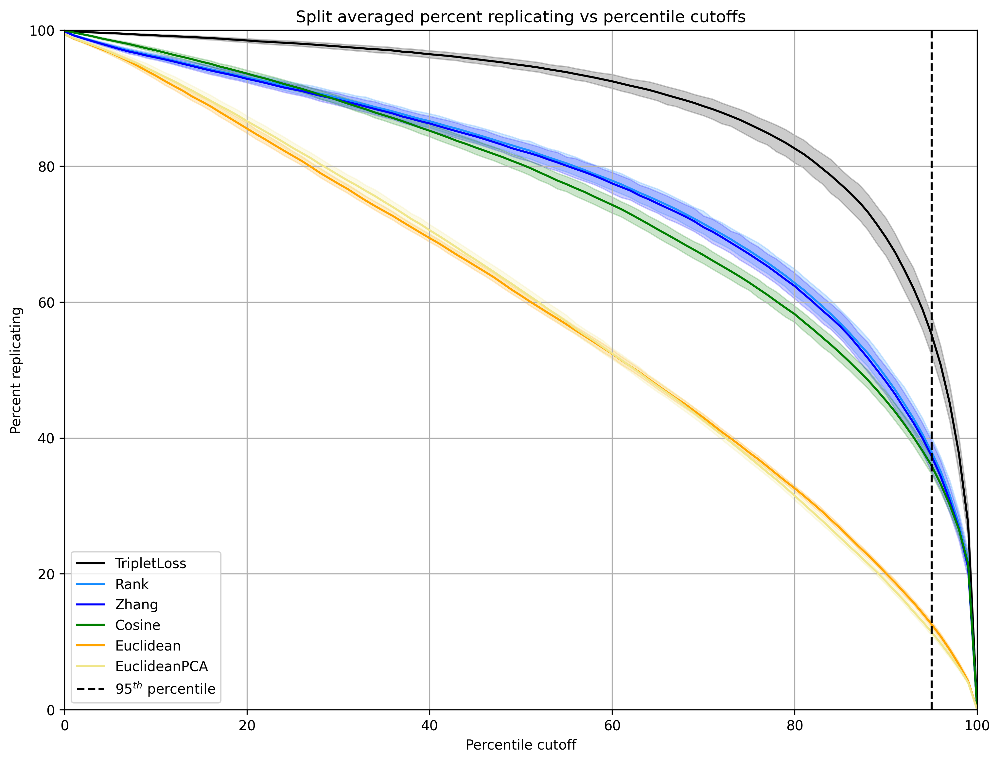

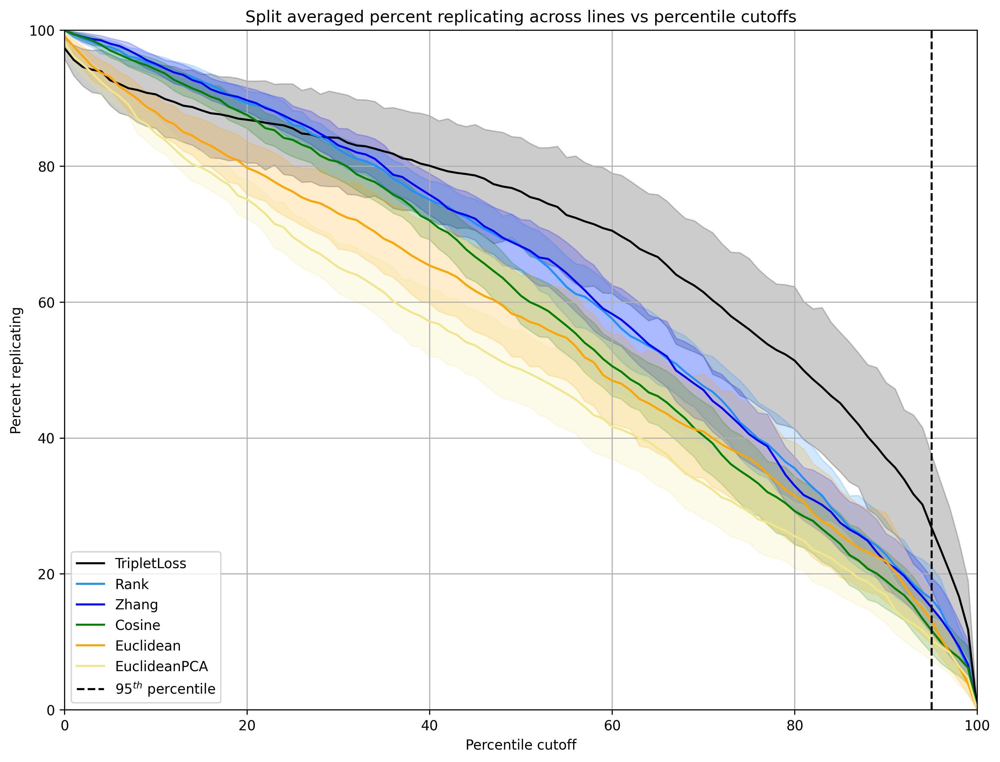

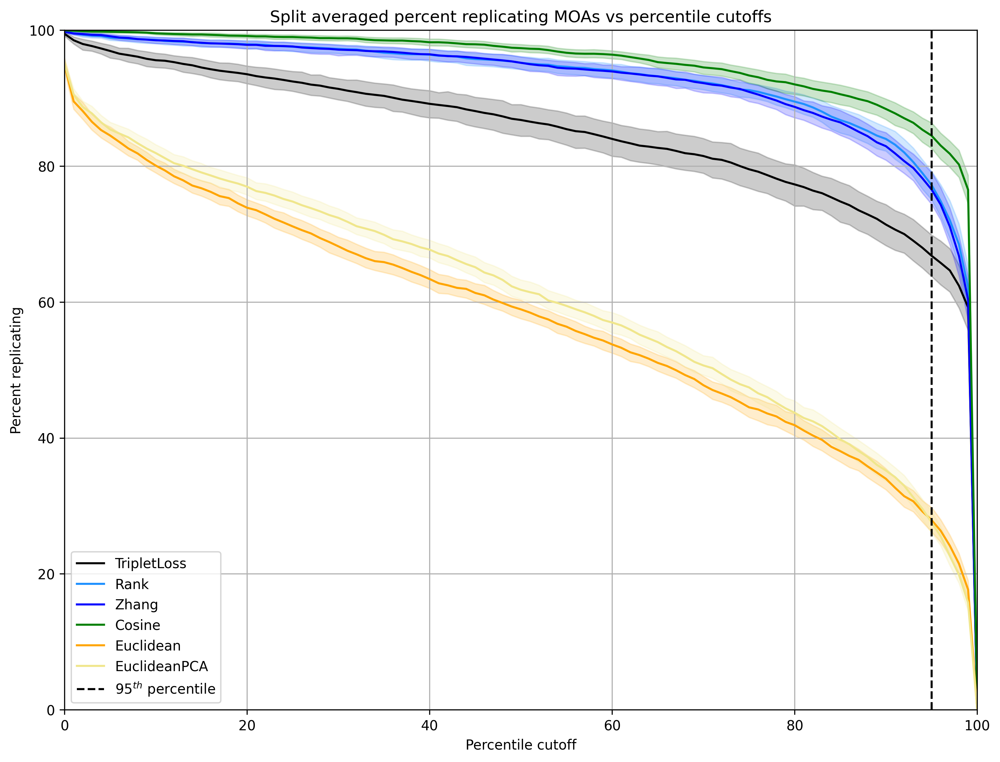

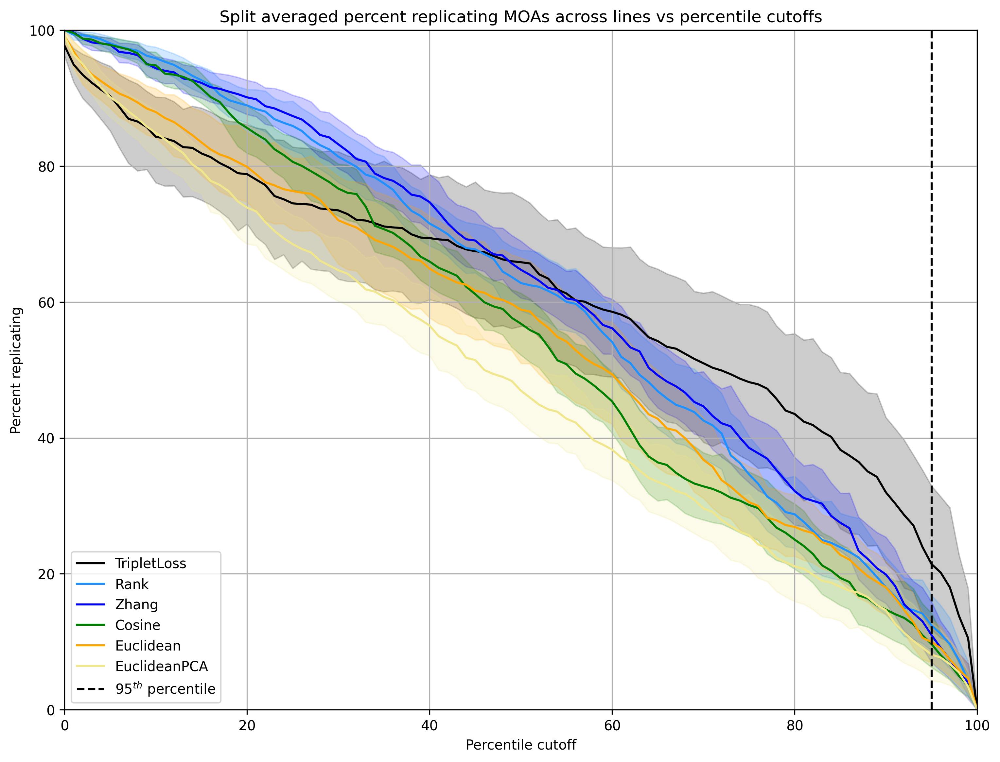

In [10]:
import seaborn as sns
import phenonaut
import numpy as np
from pathlib import Path
from phenonaut.metrics.non_ds_phenotypic_metrics import metrics_with_magic_values
from leakproofcmap.model_to_metric import get_phenonaut_metric_from_model_checkpoint
from leakproofcmap.models.tripletloss import CMAPTripletLossLightningModule
from leakproofcmap.data_wrangling import postprocess_pr_files_unmerged
import pandas as pd
from itertools import combinations
from scipy.stats import kruskal, wilcoxon, false_discovery_control
from matplotlib import pyplot as plt
import leakproofcmap
#from l1000bench import palette
SEED=7
MODEL_NAME="TripletLoss"
MODEL_IDENTIFIER="155"
CELL_LINE_SPLIT=1
PERTURBATION_SPLIT=1
working_dir=Path("working_dir")
checkpoint_dir=working_dir/Path(MODEL_NAME)/Path("trained")/Path(MODEL_IDENTIFIER)/Path("checkpoints")
metric_display_order_in_tables=['TripletLoss', 'Rank', 'Zhang', 'Cosine', 'Euclidean', 'EuclideanPCA']
metric=get_phenonaut_metric_from_model_checkpoint("TripletLoss", CMAPTripletLossLightningModule,checkpoint_dir/Path(f"cmap_split_cls_{CELL_LINE_SPLIT}_moas_{PERTURBATION_SPLIT}_seed_{SEED}.ckpt"),higher_is_better=False, cuda=True)
all_metrics=dict(**metrics_with_magic_values, **{"TripletLoss":metric})

unmerged_pr_output_dir=(working_dir/Path("plot_data")/Path(MODEL_NAME)/Path(MODEL_IDENTIFIER)/Path("compactnessunmerged"))
if not unmerged_pr_output_dir.exists():
    unmerged_pr_output_dir.mkdir(parents=True, exist_ok=True)
pr_visualisations=[
    {
        'pr_type':'compactness',
        'raw_plot_data':unmerged_pr_output_dir/Path(f"plot_compactnessunmerged_cutoffs_cmap_seed_{SEED}.csv"),
        'plot_title':f"Split averaged percent replicating vs percentile cutoffs"
    },
    {
        'pr_type':'compactness_across_lines',
        'raw_plot_data':unmerged_pr_output_dir/Path(f"plot_compactnessunmerged_cutoffs_cmap_across_lines_seed_{SEED}.csv"),
        'plot_title':f"Split averaged percent replicating across lines vs percentile cutoffs"
    },
    {
        'pr_type':'compactness_moas',
        'raw_plot_data':unmerged_pr_output_dir/Path(f"plot_compactnessunmerged_cutoffs_cmap_moas_seed_{SEED}.csv"),
        'plot_title':f"Split averaged percent replicating MOAs vs percentile cutoffs"
    },
    {
        'pr_type':'compactness_across_lines_moas',
        'raw_plot_data':unmerged_pr_output_dir/Path(f"plot_compactnessunmerged_cutoffs_cmap_across_lines_moas_seed_{SEED}.csv"),
        'plot_title':f"Split averaged percent replicating MOAs across lines vs percentile cutoffs"
    },
]

for pr_visualisation in pr_visualisations:
    raw_plot_data=pr_visualisation['raw_plot_data']
    if not pr_visualisation['raw_plot_data'].exists():
        postprocess_pr_files_unmerged(seed=SEED,model_name=MODEL_NAME, model_identifier=MODEL_IDENTIFIER, restrict_pr_type=pr_visualisation['pr_type'])
    plot_df=pd.read_csv(pr_visualisation['raw_plot_data'])
    non_merged_pr_file_path=Path(str(pr_visualisation['raw_plot_data'].parents[1]/Path(pr_visualisation['pr_type'])/pr_visualisation['raw_plot_data'].stem.replace("compactnessunmerged_", "compactness_"))+"_95pctl.csv")
    if non_merged_pr_file_path.exists():
        ranked_metric_list=pd.read_csv(non_merged_pr_file_path)['similarity metric'].tolist()
        print(ranked_metric_list)
    else:
        print(f"Could not find the unmerged PR file {non_merged_pr_file_path} to obtained similarity metric rankings, using average PR of folds, which may be different. You might consider running the preprocessing of regular, unmerged PR files first")
        ranked_metric_list=plot_df.query("`cutoff percentile` == 95").groupby('similarity metric').mean(numeric_only=True).sort_values('percent replicating', ascending=False).index
    fig, ax=plt.subplots(1,figsize=(12,9), dpi=300)
    for rmn in ranked_metric_list:
        sns.lineplot(plot_df.query("`similarity metric` == @rmn"), x="cutoff percentile", y='percent replicating',  hue='similarity metric', ax=ax, sort=False,palette=leakproofcmap.palette, err_style='band')
    
    ax.grid()
    ax.axvline(95, 0,100, linestyle='--', color='k', label=r'$95^{th}$ percentile')
    ax.set_xlim(0,100)
    ax.set_ylim(0,100)
    ax.set_xlabel("Percentile cutoff")
    ax.set_ylabel("Percent replicating")
    ax.set_title(pr_visualisation['plot_title'])
    ax.legend()
    fig.show()
    method_means={}
    for idx, df in plot_df.query("`cutoff percentile`==95").reset_index()[['similarity metric', 'percent replicating', 'split']].groupby("similarity metric"):
        method_means[idx]=df.sort_values("split")['percent replicating']
    print("kruskal:", kruskal(*list(method_means.values())))
    wilcoxon_pvals=pd.DataFrame()
    for m1 in ranked_metric_list:
        if np.all(method_means[m1]==0):
            continue
        for m2 in ranked_metric_list:
            if np.all(method_means[m2]==0):
                continue
            if m1==m2:
                wilcoxon_pvals.loc[m1, m2]=pd.NA
                continue
            delta_m1_m2=method_means[m1].values-method_means[m2].values
            if np.all(delta_m1_m2==0):
                print("All zeros")
                continue
            wilcoxon_pvals.loc[m1, m2]=wilcoxon(delta_m1_m2,None, alternative='greater').pvalue
    wilcoxon_pvals=wilcoxon_pvals.fillna(np.nan)
    display("Wilcoxon test-derived pvalues:")
    display(wilcoxon_pvals)
    wilcoxon_pvals.to_csv(str(pr_visualisation['raw_plot_data']).replace("plot_compactnessunmerged", "wilcoxon_pvals_"))


    fdr_corrected_pvals=false_discovery_control([p for p in wilcoxon_pvals.values.ravel() if not np.isnan(p)])
    fdr_corrected_pvals_iter=iter(fdr_corrected_pvals)
    for row, col, value in [tuple(x) for x in wilcoxon_pvals.stack().reset_index().values.tolist()]:
        if np.isnan(value):
            continue
        wilcoxon_pvals.loc[row, col]=next(fdr_corrected_pvals_iter)
    wilcoxon_pvals.to_csv(str(pr_visualisation['raw_plot_data']).replace("plot_compactnessunmerged", "wilcoxonfdrcorrected_pvals_"))
    display("FDR-corrected Wilcoxon test-derived pvalues:")
    display(wilcoxon_pvals)
    metric_pr_score_df=plot_df.query("`cutoff percentile`==95").reset_index()[['similarity metric', 'percent replicating']].groupby("similarity metric").agg(["mean", "std"])
    display("Merged splits")
    display(metric_pr_score_df.loc[metric_display_order_in_tables].round(3))
    metric_pr_score_df.to_csv(str(pr_visualisation['raw_plot_data'].with_suffix(""))+"_95pctl.csv")
    fig.savefig(str(pr_visualisation['raw_plot_data'].with_suffix(""))+"_area.png",pad_inches=0, bbox_inches='tight')
    fig.savefig(str(pr_visualisation['raw_plot_data'].with_suffix(""))+"_area.svg",pad_inches=0, bbox_inches='tight')


### Plots comprised of individual traces

Read in...working_dir/plot_data/TripletLoss/155/compactnessunmerged/plot_compactnessunmerged_cutoffs_cmap_seed_7.csv, (15150, 5)
Index(['EuclideanPCA', 'Euclidean', 'Cosine', 'Zhang', 'Rank', 'TripletLoss'], dtype='object', name='similarity metric')
Done sorting


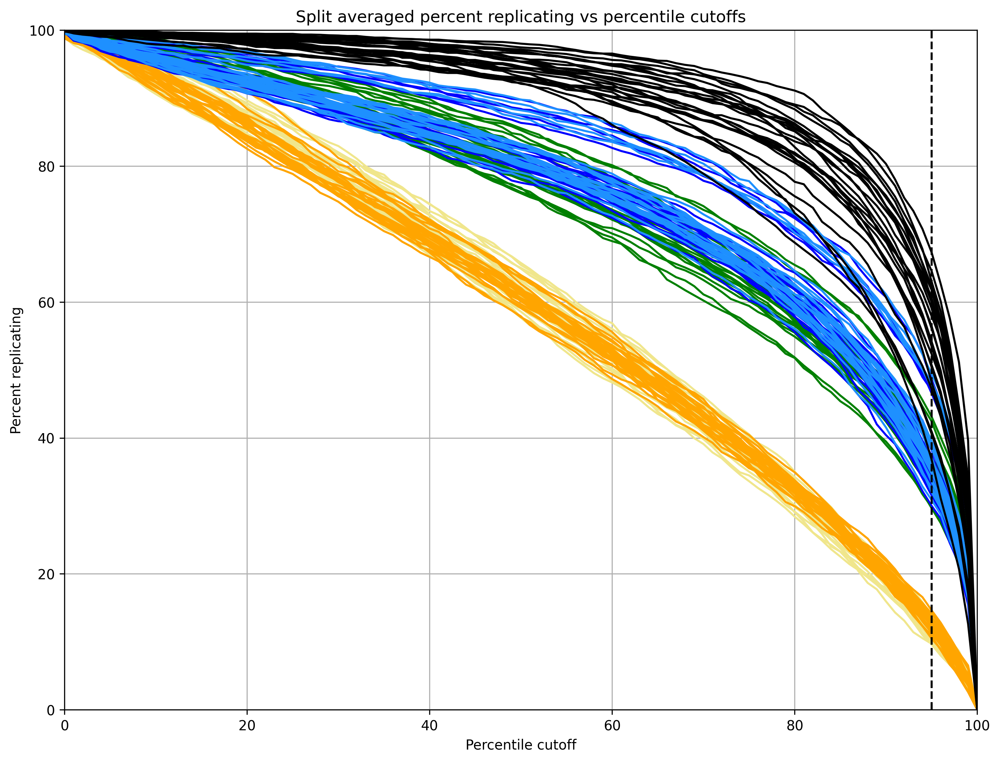

       Unnamed: 0  cutoff percentile  percent replicating similarity metric  \
95             95               95.0            35.104423            Cosine   
196           196               95.0            35.161069            Cosine   
297           297               95.0            38.572251            Cosine   
398           398               95.0            32.322581            Cosine   
499           499               95.0            39.071155            Cosine   
...           ...                ...                  ...               ...   
14740       14740               95.0            33.616728              Rank   
14841       14841               95.0            35.332419              Rank   
14942       14942               95.0            33.937346              Rank   
15043       15043               95.0            38.774194              Rank   
15144       15144               95.0            47.668394              Rank   

          split  
95     cls5_ps3  
196    cls4_ps2

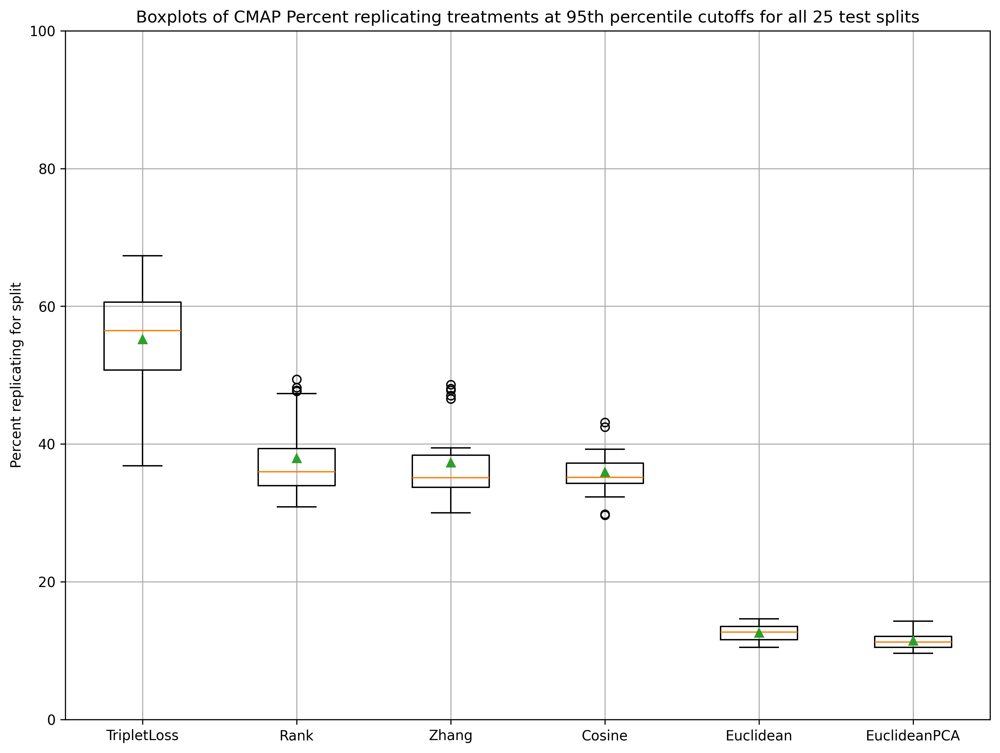

Read in...working_dir/plot_data/TripletLoss/155/compactnessunmerged/plot_compactnessunmerged_cutoffs_cmap_across_lines_seed_7.csv, (15150, 5)
Index(['EuclideanPCA', 'Cosine', 'Euclidean', 'Zhang', 'Rank', 'TripletLoss'], dtype='object', name='similarity metric')
Done sorting


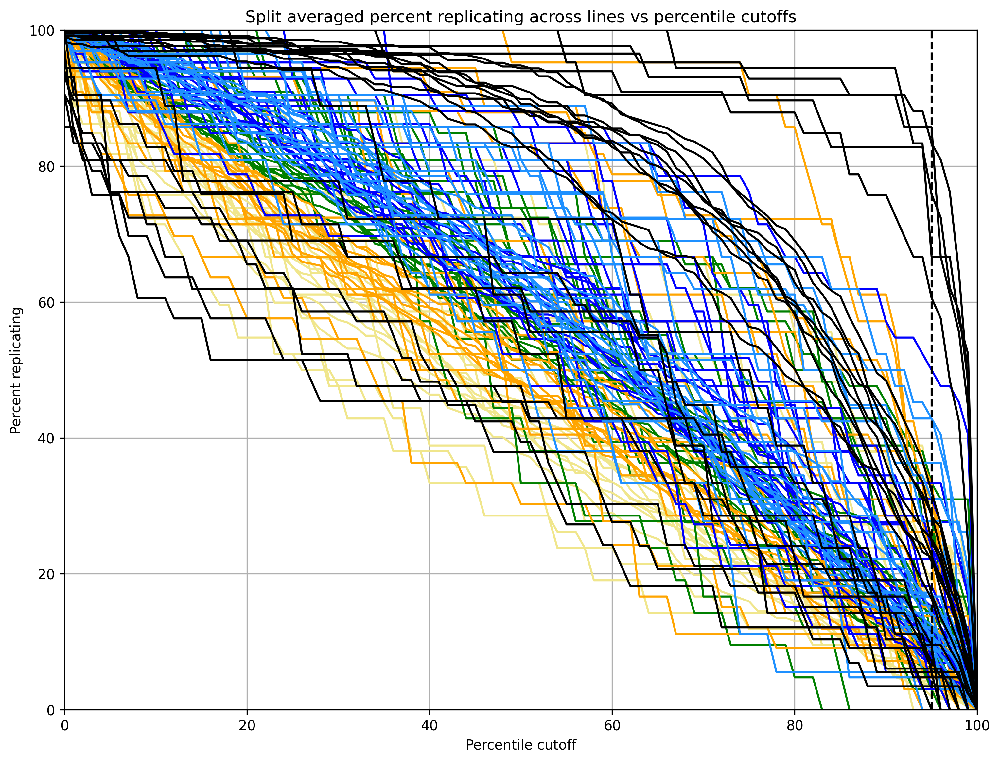

       Unnamed: 0  cutoff percentile  percent replicating similarity metric  \
95             95               95.0             0.000000            Cosine   
196           196               95.0            12.184874            Cosine   
297           297               95.0            14.285714            Cosine   
398           398               95.0             3.030303            Cosine   
499           499               95.0             7.364341            Cosine   
...           ...                ...                  ...               ...   
14740       14740               95.0            10.077519              Rank   
14841       14841               95.0            10.800000              Rank   
14942       14942               95.0            14.285714              Rank   
15043       15043               95.0            13.793103              Rank   
15144       15144               95.0            27.777778              Rank   

          split  
95     cls1_ps3  
196    cls4_ps1

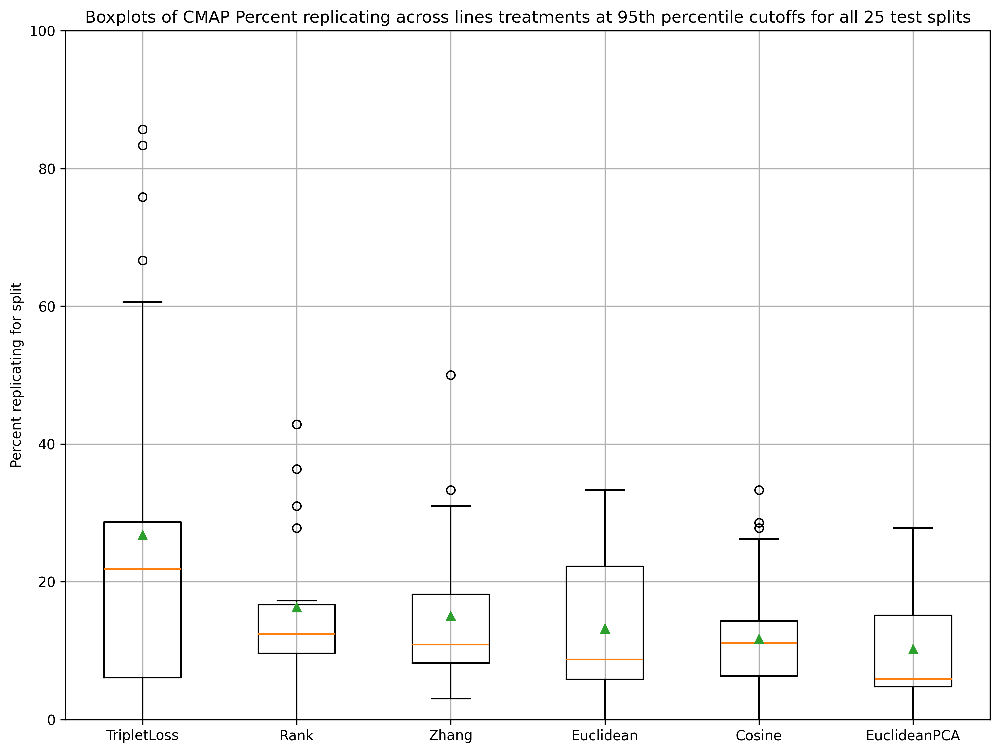

Read in...working_dir/plot_data/TripletLoss/155/compactnessunmerged/plot_compactnessunmerged_cutoffs_cmap_moas_seed_7.csv, (15150, 5)
Index(['EuclideanPCA', 'Euclidean', 'TripletLoss', 'Zhang', 'Rank', 'Cosine'], dtype='object', name='similarity metric')
Done sorting


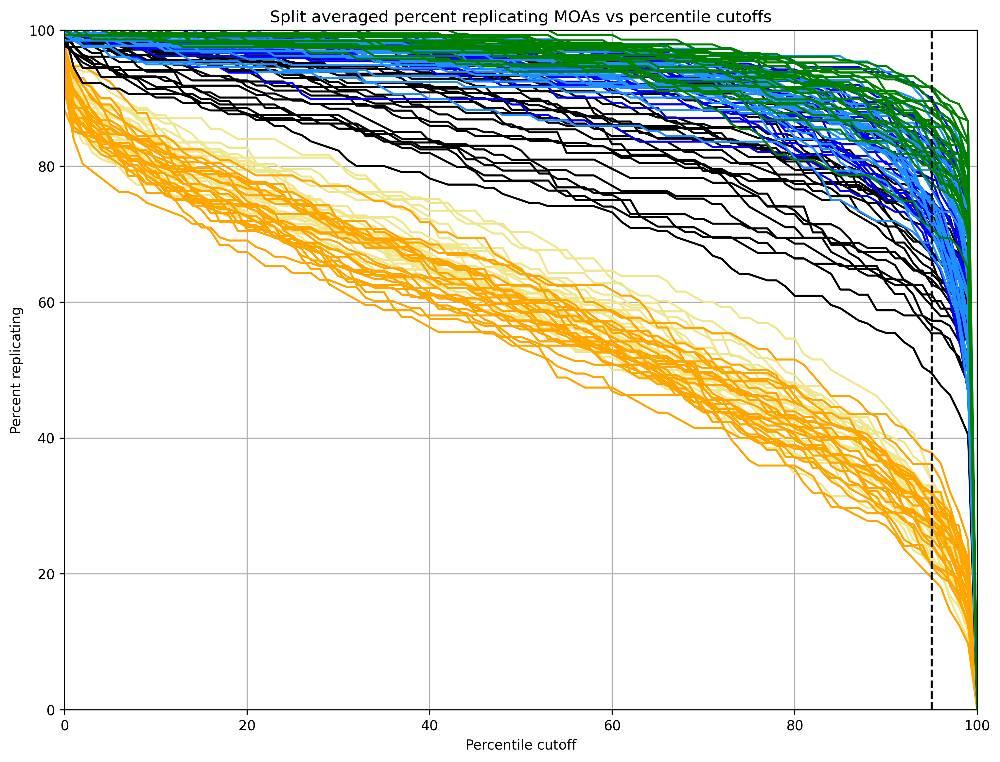

       Unnamed: 0  cutoff percentile  percent replicating similarity metric  \
95             95               95.0            70.992366            Cosine   
196           196               95.0            80.357143            Cosine   
297           297               95.0            85.446009            Cosine   
398           398               95.0            88.421053            Cosine   
499           499               95.0            85.781991            Cosine   
...           ...                ...                  ...               ...   
14740       14740               95.0            74.809160              Rank   
14841       14841               95.0            71.428571              Rank   
14942       14942               95.0            72.656250              Rank   
15043       15043               95.0            81.363636              Rank   
15144       15144               95.0            82.993197              Rank   

          split  
95     cls2_ps3  
196    cls3_ps2

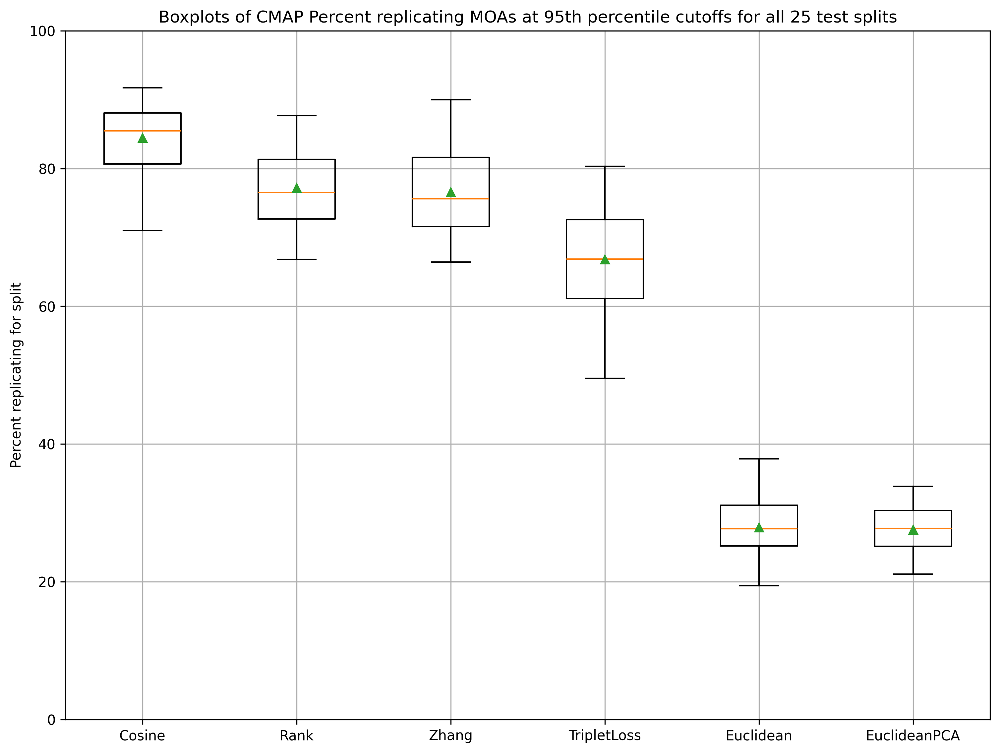

Read in...working_dir/plot_data/TripletLoss/155/compactnessunmerged/plot_compactnessunmerged_cutoffs_cmap_across_lines_moas_seed_7.csv, (15150, 5)
Index(['EuclideanPCA', 'Cosine', 'Euclidean', 'Zhang', 'Rank', 'TripletLoss'], dtype='object', name='similarity metric')
Done sorting


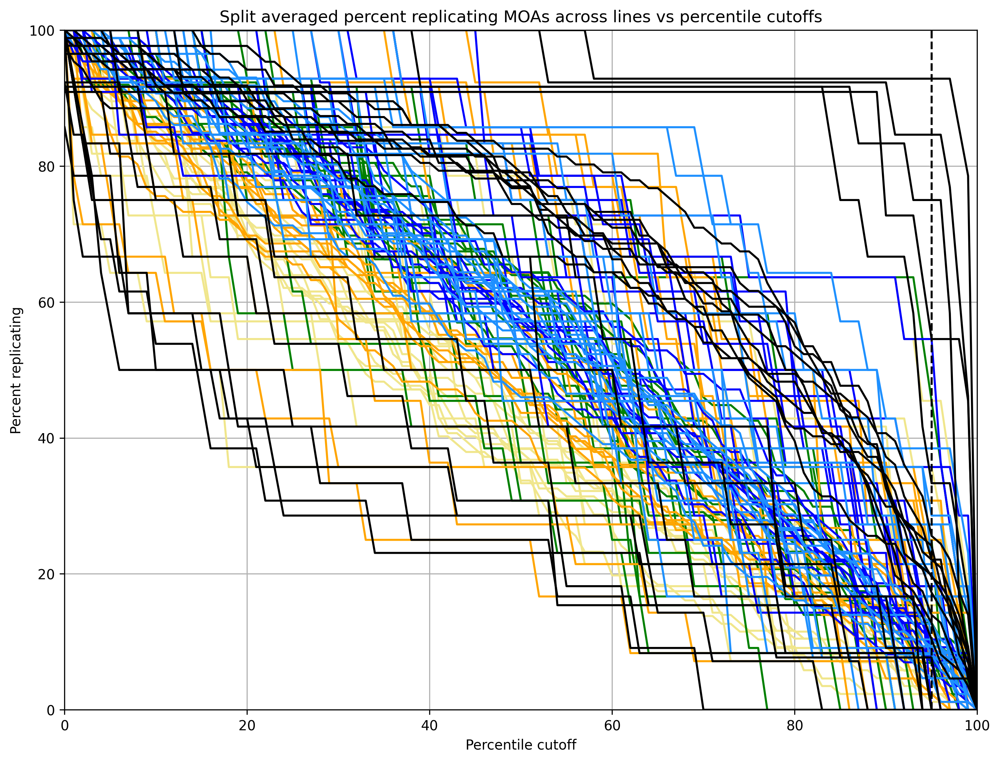

       Unnamed: 0  cutoff percentile  percent replicating similarity metric  \
95             95               95.0            12.790698            Cosine   
196           196               95.0             6.896552            Cosine   
297           297               95.0             7.692308            Cosine   
398           398               95.0             0.000000            Cosine   
499           499               95.0            16.666667            Cosine   
...           ...                ...                  ...               ...   
14740       14740               95.0            27.272727              Rank   
14841       14841               95.0            16.666667              Rank   
14942       14942               95.0             0.000000              Rank   
15043       15043               95.0             9.195402              Rank   
15144       15144               95.0            21.428571              Rank   

          split  
95     cls5_ps3  
196    cls4_ps2

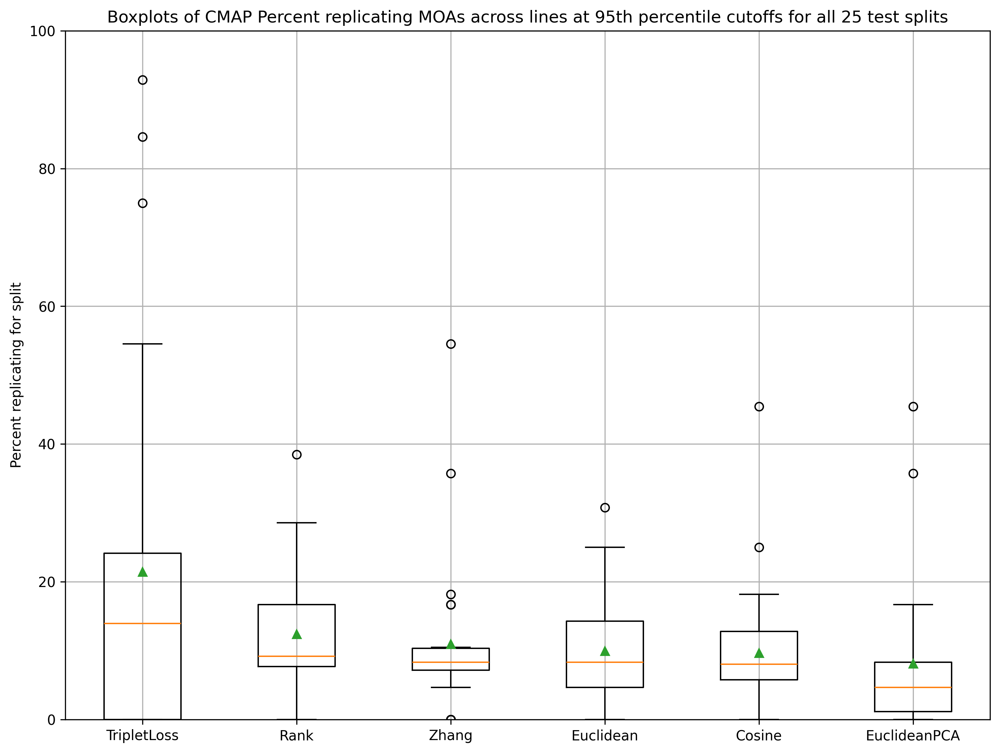

In [11]:
import seaborn as sns
from pathlib import Path
from leakproofcmap.data_wrangling import postprocess_pr_files_unmerged
import pandas as pd
from matplotlib import pyplot as plt
import numpy as np
from leakproofcmap import palette
SEED=7
MODEL_NAME="TripletLoss"
MODEL_IDENTIFIER="155"
CELL_LINE_SPLIT=1
PERTURBATION_SPLIT=1
working_dir=Path("working_dir")
display_repeat_style='all_lines'
metric_display_order_in_tables=['TripletLoss', 'Rank', 'Zhang', 'Cosine', 'Euclidean', 'EuclideanPCA']
unmerged_pr_output_dir=(working_dir/Path("plot_data")/Path(MODEL_NAME)/Path(MODEL_IDENTIFIER)/Path("compactnessunmerged"))
if not unmerged_pr_output_dir.exists():
    unmerged_pr_output_dir.mkdir(parents=True, exist_ok=True)
pr_visualisations=[
    {
        'pr_type':'compactness',
        'raw_plot_data':unmerged_pr_output_dir/Path(f"plot_compactnessunmerged_cutoffs_cmap_seed_{SEED}.csv"),
        'plot_title':f"Split averaged percent replicating vs percentile cutoffs"
    },
    {
        'pr_type':'compactness_across_lines',
        'raw_plot_data':unmerged_pr_output_dir/Path(f"plot_compactnessunmerged_cutoffs_cmap_across_lines_seed_{SEED}.csv"),
        'plot_title':f"Split averaged percent replicating across lines vs percentile cutoffs"
    },
    {
        'pr_type':'compactness_moas',
        'raw_plot_data':unmerged_pr_output_dir/Path(f"plot_compactnessunmerged_cutoffs_cmap_moas_seed_{SEED}.csv"),
        'plot_title':f"Split averaged percent replicating MOAs vs percentile cutoffs"
    },
    {
        'pr_type':'compactness_across_lines_moas',
        'raw_plot_data':unmerged_pr_output_dir/Path(f"plot_compactnessunmerged_cutoffs_cmap_across_lines_moas_seed_{SEED}.csv"),
        'plot_title':f"Split averaged percent replicating MOAs across lines vs percentile cutoffs"
    },
]


pr_boxplot_info={
    'compactness':
    {
        'raw_plot_data':unmerged_pr_output_dir/Path(f"plot_prunmerged_boxplots_at_95thpct_cmap_seed_{SEED}.csv"),
        'plot_title':f"Boxplots of CMAP Percent replicating treatments at 95th percentile cutoffs for all 25 test splits"
    },
    'compactness_across_lines':
    {
        'raw_plot_data':unmerged_pr_output_dir/Path(f"plot_prunmerged_boxplots_at_95thpct_cmap_across_lines_seed_{SEED}.csv"),
        'plot_title':f"Boxplots of CMAP Percent replicating across lines treatments at 95th percentile cutoffs for all 25 test splits"
    },
    'compactness_moas':
    {
        'raw_plot_data':unmerged_pr_output_dir/Path(f"plot_prunmerged_boxplots_at_95thpct_cmap_moas_seed_{SEED}.csv"),
        'plot_title':f"Boxplots of CMAP Percent replicating MOAs at 95th percentile cutoffs for all 25 test splits"
    },
    'compactness_across_lines_moas':
    {
        'raw_plot_data':unmerged_pr_output_dir/Path(f"plot_prunmerged_boxplots_at_95thpct_cmap_across_lines_moas_seed_{SEED}.csv"),
        'plot_title':f"Boxplots of CMAP Percent replicating MOAs across lines at 95th percentile cutoffs for all 25 test splits"
    },
}

for pr_visualisation in pr_visualisations:
    raw_plot_data=pr_visualisation['raw_plot_data']
    if not pr_visualisation['raw_plot_data'].exists():
        postprocess_pr_files_unmerged(seed=SEED,model_name=MODEL_NAME, model_identifier=MODEL_IDENTIFIER, restrict_pr_type=pr_visualisation['pr_type'])
    raw_plot_data=pr_visualisation['raw_plot_data']
    plot_df=pd.read_csv(raw_plot_data)
    print(f"Read in...{raw_plot_data}, {plot_df.shape}")
    ranked_metric_list=plot_df.query("`cutoff percentile` == 95").groupby('similarity metric').mean(numeric_only=True).sort_values("percent replicating", ascending=False)['percent replicating'].sort_values().index
    print(ranked_metric_list)
    print("Done sorting")
    fig, ax=plt.subplots(1,figsize=(12,9), dpi=300)
    for rmn in ranked_metric_list:
        if display_repeat_style=='all_lines':
            for split in plot_df.split.unique():
                sns.lineplot(plot_df.query("`similarity metric` == @rmn and split==@split"), x="cutoff percentile", y='percent replicating',  hue='similarity metric', ax=ax, sort=False,palette=palette, err_style='band')
    ax.grid()
    ax.axvline(95, 0,100, linestyle='--', color='k', label=r'$95^{th}$ percentile')
    ax.set_xlim(0,100)
    ax.set_ylim(0,100)
    ax.set_xlabel("Percentile cutoff")
    ax.set_ylabel("Percent replicating")
    ax.set_title(pr_visualisation['plot_title'])
    plt.legend([],[], frameon=False)
    plt.show()
    fig.savefig(str(raw_plot_data.with_suffix(""))+"_lines.svg",pad_inches=0, bbox_inches='tight')
    fig.savefig(str(raw_plot_data.with_suffix(""))+"_lines.png",pad_inches=0, bbox_inches='tight', dpi=300)
    #plt.close()

    fig, ax=plt.subplots(1,figsize=(12,9), dpi=300)
    plot_by_metric_df=plot_df.query("`cutoff percentile` == 95")
    plot_order=plot_by_metric_df.groupby("similarity metric")['percent replicating'].mean().sort_values(ascending=False).index
    data=[]
    print(plot_by_metric_df)
    for sm in plot_order:
        data.append(plot_by_metric_df.query("`similarity metric`==@sm")['percent replicating'])
    ax.boxplot(data, labels=plot_order, showmeans=True)

    ax.set_ylim(0,100)
    ax.set_ylabel("Percent replicating for split")
    ax.set_title(pr_boxplot_info[pr_visualisation['pr_type']]['plot_title'])
    stats_df=pd.DataFrame(data=np.array(data).T, columns=plot_order)
    print(stats_df.describe().round(3))
    stats_df.to_csv(pr_boxplot_info[pr_visualisation['pr_type']]['raw_plot_data'])
    stats_df.describe().to_csv(str(pr_boxplot_info[pr_visualisation['pr_type']]['raw_plot_data']).replace(".csv", "_stats.csv"))
    plt.grid()

    fig.savefig(pr_boxplot_info[pr_visualisation['pr_type']]['raw_plot_data'].with_suffix(".png"),pad_inches=0, bbox_inches='tight')
    fig.savefig(pr_boxplot_info[pr_visualisation['pr_type']]['raw_plot_data'].with_suffix(".svg"),pad_inches=0, bbox_inches='tight')
    plt.show()



### Mcnemar's statistical test

In [12]:
# Apply McNemar's test to evaluate replicating rates
from pathlib import Path
import json
import pandas as pd
from matplotlib import pyplot as plt
from statsmodels.stats.contingency_tables import mcnemar
import numpy as np
SEED=7
MODEL_NAME="TripletLoss"
MODEL_IDENTIFIER="155"
working_dir=Path("working_dir")
metric_display_order_in_tables=['TripletLoss', 'Rank', 'Zhang', 'Cosine', 'Euclidean', 'EuclideanPCA']
checkpoint_dir=working_dir/Path(MODEL_NAME)/Path("trained")/Path(MODEL_IDENTIFIER)/Path("checkpoints")

pr_visualisations=[
    {
        'pr_type':'compactness',
        'raw_plot_data':working_dir/Path("plot_data")/Path(MODEL_NAME)/Path(MODEL_IDENTIFIER)/Path("compactness"),
    },
    {
        'pr_type':'compactness_across_lines',
        'raw_plot_data':working_dir/Path("plot_data")/Path(MODEL_NAME)/Path(MODEL_IDENTIFIER)/Path("compactness_across_lines"),
    },
    {
        'pr_type':'compactness_moas',
        'raw_plot_data':working_dir/Path("plot_data")/Path(MODEL_NAME)/Path(MODEL_IDENTIFIER)/Path("compactness_moas"),
    },
    {
        'pr_type':'compactness_across_lines_moas',
        'raw_plot_data':working_dir/Path("plot_data")/Path(MODEL_NAME)/Path(MODEL_IDENTIFIER)/Path("compactness_across_lines_moas"),
    },
]

for pr_visualisation in pr_visualisations:
    perf_df=pd.DataFrame()
    print(pr_visualisation['raw_plot_data'])
    metrics=set([f.stem.split("_")[1] for f in pr_visualisation['raw_plot_data'].glob(f"pr_*_cls*_ps*_seed_{SEED}.csv")])
    for metric in metrics:
        re_non_rep_dict=pd.concat([pd.read_csv(f, usecols=['is_replicating']) for f in [fnojump for fnojump in pr_visualisation['raw_plot_data'].glob(f"pr_{metric}_*cls*_ps*_seed_{SEED}.csv") if "jump" not in fnojump.stem]]).value_counts().to_dict()
        perf_df.loc[metric, ['replicating', 'non_replicating']]=re_non_rep_dict[(1,)],re_non_rep_dict[(0,)]
    perf_df=perf_df.sort_values("replicating", ascending=False)
    perf_df['Percent replicating']=(perf_df['replicating']/(perf_df['replicating']+perf_df['non_replicating']))*100

    best_scoring_metric, second_best_scoring_metric=perf_df.index[0:2].tolist()
    print(f"Testing top 2 ({best_scoring_metric} & {second_best_scoring_metric}) using Mcnemar's test")

    rank_1_df=pd.concat([pd.read_csv(f, index_col=0, usecols=['Unnamed: 0', 'is_replicating']) for f in [fnojump for fnojump in pr_visualisation['raw_plot_data'].glob(f"pr_{best_scoring_metric}_*cls*_ps*_seed_{SEED}.csv") if "jump" not in fnojump.stem]])
    rank_2_df=pd.concat([pd.read_csv(f, index_col=0, usecols=['Unnamed: 0', 'is_replicating']) for f in [fnojump for fnojump in pr_visualisation['raw_plot_data'].glob(f"pr_{second_best_scoring_metric}_*cls*_ps*_seed_{SEED}.csv") if "jump" not in fnojump.stem]])
    merged_df=rank_1_df.merge(rank_2_df, left_index=True, right_index=True,suffixes=(f"_{best_scoring_metric}", f"_{second_best_scoring_metric}"))
    contingency_table=np.array([
        [np.sum((merged_df[f'is_replicating_{best_scoring_metric}']==1) & (merged_df[f'is_replicating_{second_best_scoring_metric}']==1)),np.sum((merged_df[f'is_replicating_{best_scoring_metric}']==1) & (merged_df[f'is_replicating_{second_best_scoring_metric}']==0))],
        [np.sum((merged_df[f'is_replicating_{best_scoring_metric}']==0) & (merged_df[f'is_replicating_{second_best_scoring_metric}']==1)),np.sum((merged_df[f'is_replicating_{best_scoring_metric}']==0) & (merged_df[f'is_replicating_{second_best_scoring_metric}']==0))],
    ])
    mcnemar_results=mcnemar(contingency_table)
    print(mcnemar_results)
    json.dump({'contingency_table':contingency_table.tolist(), 'mcnemar_results':{'pvalue':float(mcnemar_results.pvalue), 'statistic':float(mcnemar_results.pvalue)}}, open(pr_visualisation['raw_plot_data']/"mcnemar_pvalues.json", 'w'))


working_dir/plot_data/TripletLoss/155/compactness
Testing top 2 (TripletLoss & Rank) using Mcnemar's test
pvalue      0.0
statistic   7342.0
working_dir/plot_data/TripletLoss/155/compactness_across_lines
Testing top 2 (TripletLoss & Rank) using Mcnemar's test
pvalue      9.567179641874015e-93
statistic   855.0
working_dir/plot_data/TripletLoss/155/compactness_moas
Testing top 2 (Cosine & Rank) using Mcnemar's test
pvalue      1.272074949765056e-28
statistic   229.0
working_dir/plot_data/TripletLoss/155/compactness_across_lines_moas
Testing top 2 (TripletLoss & Rank) using Mcnemar's test
pvalue      9.636069497555286e-27
statistic   280.0


# Display JUMP MOA Compounds

First, we examine which JUMP MOA compounds are present in our filtered CMAP dataset

In [13]:
from pathlib import Path
from leakproofcmap.phenonaut_functions import (
    get_cmap_phenonaut_object,
)

import pandas as pd

CELL_LINE_SPLIT = 1
MOA_SPLIT = 1
working_dir=Path("working_dir")
calc_gpu_metrics=False
phenonaut_packaged_dataset_dir=Path("/local_scratch/data/phenonaut_datasets/")
# Load all CMAP data into a phenonaut object
phe = get_cmap_phenonaut_object(
    phenonaut_packaged_dataset_dir,
    working_dir=working_dir,
    pickle_dir=Path("pickles"),
)
from phenonaut.packaged_datasets import MetadataJUMPMOACompounds
jump_moa_df=MetadataJUMPMOACompounds("/local_scratch/data/phenonaut_datasets/")()
jump_moa_cpds=jump_moa_df.index.tolist()
jump_moa_cpds.remove("DMSO")
cmap_cpds=phe.df.pert_iname.unique().tolist()
intersecting_compounds=set(cmap_cpds).intersection(set(jump_moa_cpds))
print(len(cmap_cpds), "unique compounds in CMAP")
print(len(phe.df.moa.unique()), "unique MOAs in CMAP")
print(f"{len(jump_moa_cpds)} unique JUMP MOA compounds")
print(f"{len(jump_moa_df.moa.unique())} unique JUMP MOAs")
print(len(intersecting_compounds), "jump MOA compounds in CMAP")
#display(jump_moa_df.query(f"pert_iname in @intersecting_compounds"))#['moa'].unique()), "jump MOAs in CMAP")
jump_moa_cpds_in_cmap_df=pd.DataFrame()
for jmoac in set(cmap_cpds).intersection(set(jump_moa_cpds)):
    jmoac_df=phe.df.query("pert_iname == @jmoac")
    jump_moa_cpds_in_cmap_df.loc[jmoac, ['n_cmap_cpd_samples', 'present_in_n_cell_lines']]=(len(jmoac_df), len(jmoac_df.cell_id.unique()))
jump_moa_cpds_in_cmap_df[['n_cmap_cpd_samples','present_in_n_cell_lines']]=jump_moa_cpds_in_cmap_df[['n_cmap_cpd_samples','present_in_n_cell_lines']].astype(int)
jump_moa_cpds_in_cmap_df.to_csv("working_dir/plot_data/jump_moa_cpds_in_filtered_cmap.csv")
display(jump_moa_cpds_in_cmap_df)

jump_moas_in_cmap_df=pd.DataFrame()

for jmoa in set(jump_moa_df.moa.unique()):
    jmoac_df=phe.df.query("moa == @jmoa")
    jump_moas_in_cmap_df.loc[jmoa, ['n_cmap_cpds', 'n_cmap_moa_profiles', 'present_in_n_cell_lines']]=(len(jmoac_df.pert_iname.unique()),len(jmoac_df), len(jmoac_df.cell_id.unique()))
jump_moas_in_cmap_df=jump_moas_in_cmap_df.loc[~(jump_moas_in_cmap_df==0).all(axis=1)]
jump_moas_in_cmap_df[['n_cmap_cpds','n_cmap_moa_profiles','present_in_n_cell_lines']]=jump_moas_in_cmap_df[['n_cmap_cpds','n_cmap_moa_profiles','present_in_n_cell_lines']].astype(int)
jump_moas_in_cmap_df.to_csv("working_dir/plot_data/jump_moas_in_filtered_cmap.csv")
display(jump_moas_in_cmap_df)





1309 unique compounds in CMAP
433 unique MOAs in CMAP
90 unique JUMP MOA compounds
48 unique JUMP MOAs
24 jump MOA compounds in CMAP


,n_cmap_cpd_samples,present_in_n_cell_lines
sirolimus,200,28
neratinib,200,15
andarine,125,7
orphenadrine,116,7
BX-912,200,13
MK-5108,125,7
ruxolitinib,200,13
PFI-1,200,19
romidepsin,107,7
homochlorcyclizine,126,7


,n_cmap_cpds,n_cmap_moa_profiles,present_in_n_cell_lines
phospholipase inhibitor,1,116,7
histone lysine methyltransferase inhibitor,1,200,19
RAF inhibitor,6,1123,29
hepatocyte growth factor receptor inhibitor,2,325,21
Aurora kinase inhibitor,7,1094,26
histone lysine demethylase inhibitor,1,200,19
HDAC inhibitor,14,2255,24
p38 MAPK inhibitor,9,1496,24
hypoxia inducible factor inhibitor,3,437,21
HMGCR inhibitor,6,735,7


# Plot percent replicating for JUMP MOA compounds

Doing compactness


,similarity metric,percent replicating
0,TripletLoss,35.876
1,Rank,16.102
2,Zhang,15.960
3,Cosine,26.554
4,Euclidean,25.424
5,EuclideanPCA,12.994


Doing compactness_across_lines


,similarity metric,percent replicating
0,TripletLoss,0.000
1,Rank,0.000
2,Zhang,0.000
3,Cosine,9.091
4,Euclidean,9.091
5,EuclideanPCA,0.000


Doing compactness_moas


,similarity metric,percent replicating
0,TripletLoss,96.000
1,Rank,44.286
2,Zhang,44.000
3,Cosine,78.286
4,Euclidean,65.714
5,EuclideanPCA,34.857


Doing compactness_across_lines_moas


,similarity metric,percent replicating
0,TripletLoss,27.273
1,Rank,0.000
2,Zhang,9.091
3,Cosine,0.000
4,Euclidean,18.182
5,EuclideanPCA,9.091


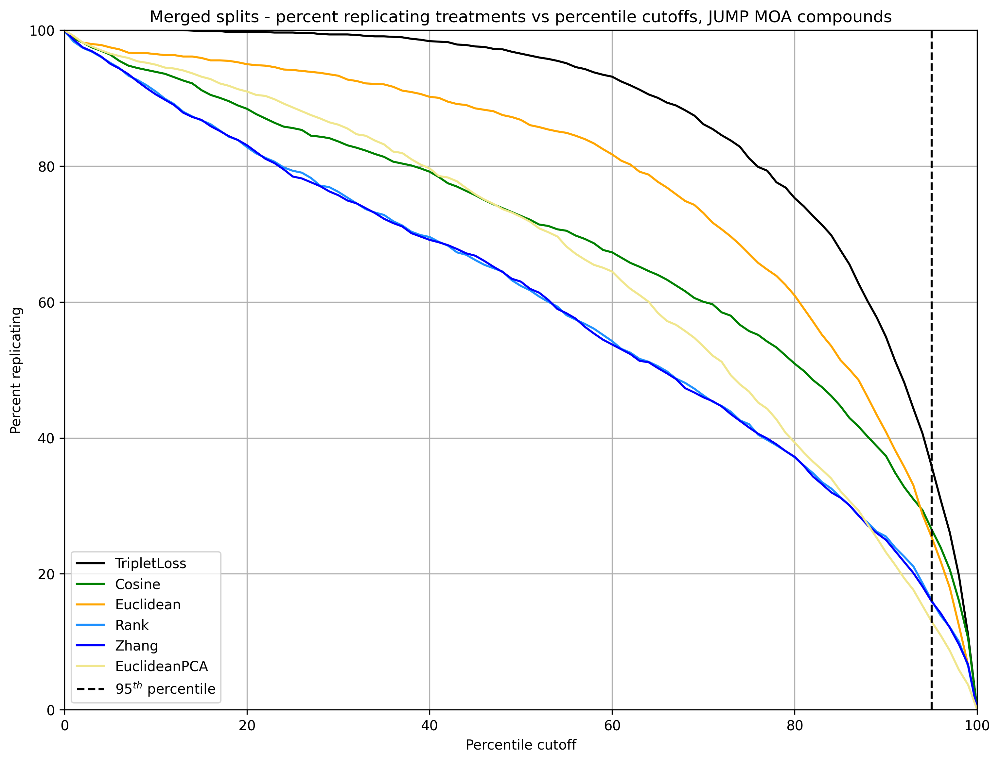

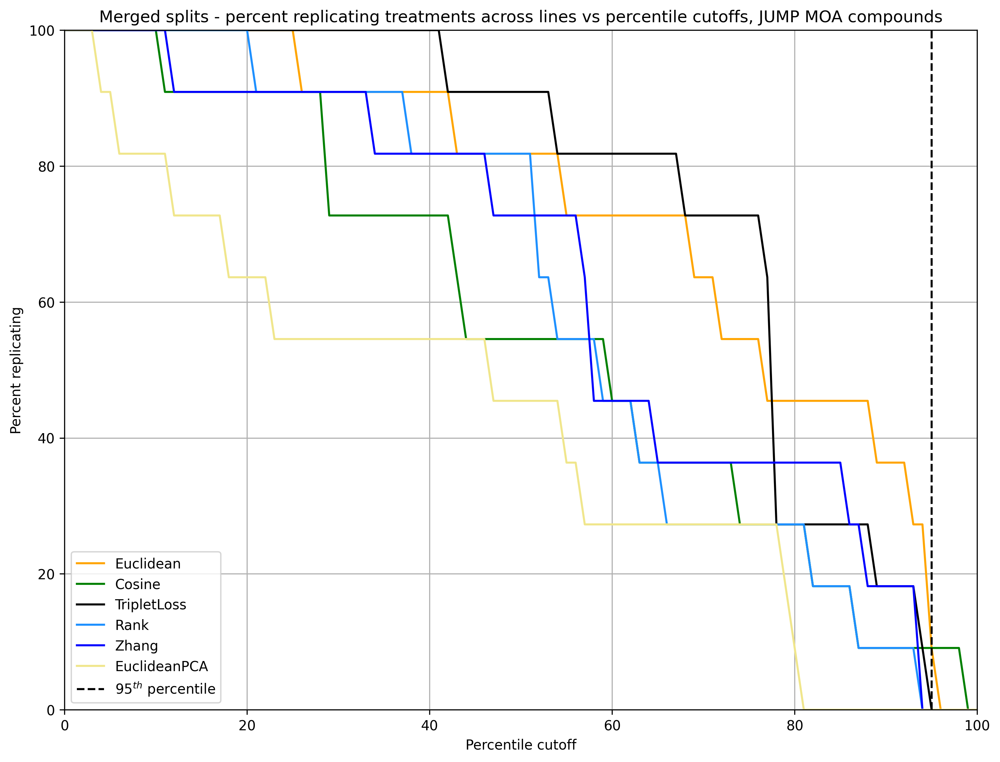

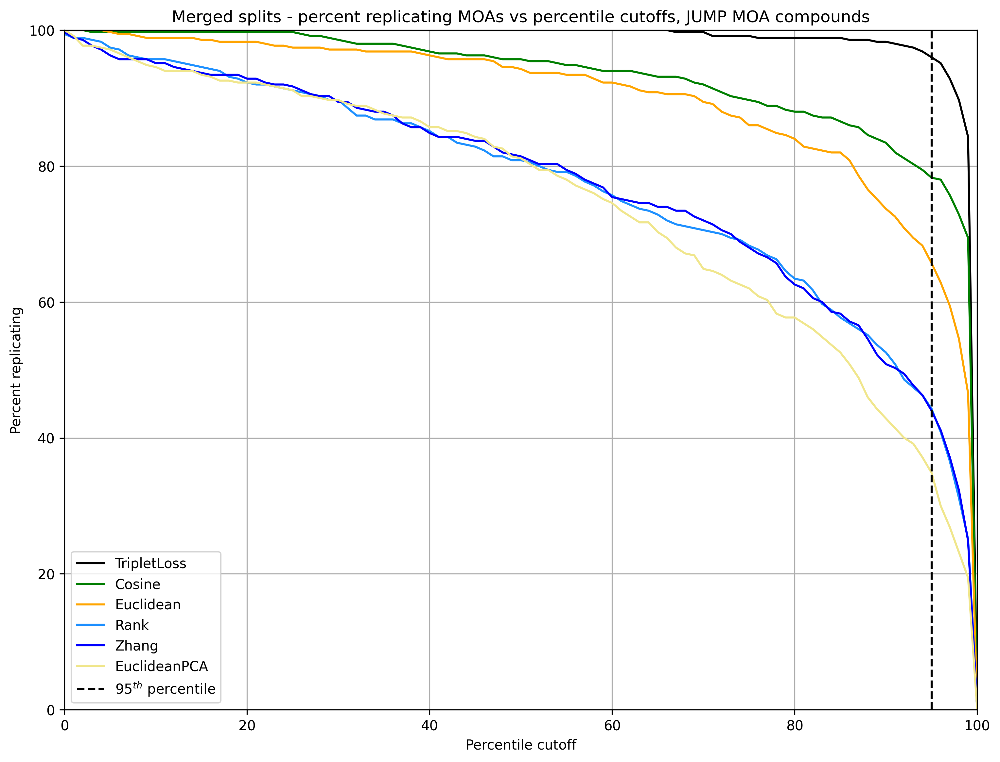

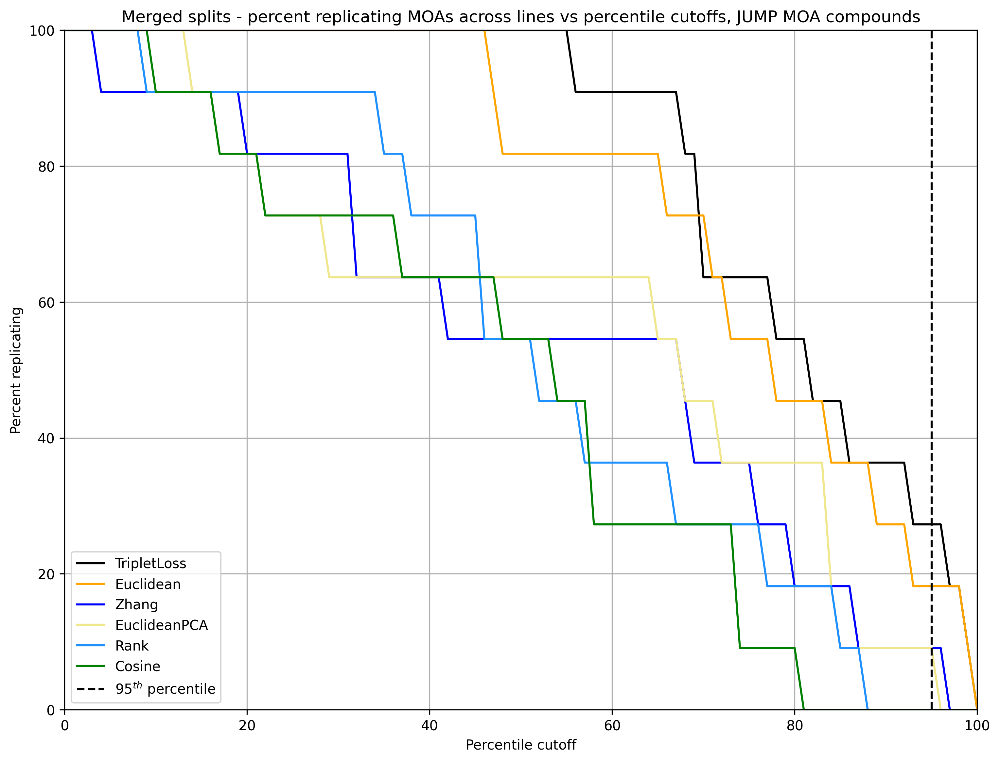

In [14]:
# Plot PR CMAP
import seaborn as sns
import phenonaut
from pathlib import Path
from leakproofcmap.data_wrangling import postprocess_pr_files
import pandas as pd
from matplotlib import pyplot as plt
import numpy as np
from leakproofcmap import palette
plt.rcParams['savefig.facecolor']='white'
SEED=7
MODEL_NAME="TripletLoss"
MODEL_IDENTIFIER="155"
CELL_LINE_SPLIT=1
PERTURBATION_SPLIT=1
working_dir=Path("working_dir")
checkpoint_dir=working_dir/Path(MODEL_NAME)/Path("trained")/Path(MODEL_IDENTIFIER)/Path("checkpoints")
metric_display_order_in_tables=['TripletLoss', 'Rank', 'Zhang', 'Cosine', 'Euclidean', 'EuclideanPCA']
pr_visualisations=[
    {
        'pr_type':'compactness',
        'raw_plot_data':working_dir/Path("plot_data")/Path(MODEL_NAME)/Path(MODEL_IDENTIFIER)/Path("compactness")/Path(f"plot_compactness_cutoffs_cmap_seed_{SEED}_jumpmoa.csv"),
        'plot_title':f"Merged splits - percent replicating treatments vs percentile cutoffs, JUMP MOA compounds"
    },
    {
        'pr_type':'compactness_across_lines',
        'raw_plot_data':working_dir/Path("plot_data")/Path(MODEL_NAME)/Path(MODEL_IDENTIFIER)/Path("compactness_across_lines")/Path(f"plot_compactness_cutoffs_cmap_across_lines_seed_{SEED}_jumpmoa.csv"),
        'plot_title':f"Merged splits - percent replicating treatments across lines vs percentile cutoffs, JUMP MOA compounds"
    },
    {
        'pr_type':'compactness_moas',
        'raw_plot_data':working_dir/Path("plot_data")/Path(MODEL_NAME)/Path(MODEL_IDENTIFIER)/Path("compactness_moas")/Path(f"plot_compactness_cutoffs_cmap_moas_seed_{SEED}_jumpmoa.csv"),
        'plot_title':f"Merged splits - percent replicating MOAs vs percentile cutoffs, JUMP MOA compounds"
    },
    {
        'pr_type':'compactness_across_lines_moas',
        'raw_plot_data':working_dir/Path("plot_data")/Path(MODEL_NAME)/Path(MODEL_IDENTIFIER)/Path("compactness_across_lines_moas")/Path(f"plot_compactness_cutoffs_cmap_across_lines_moas_seed_{SEED}_jumpmoa.csv"),
        'plot_title':f"Merged splits - percent replicating MOAs across lines vs percentile cutoffs, JUMP MOA compounds"
    },
]

for pr_visualisation in pr_visualisations:
    print(f"Doing {pr_visualisation['pr_type']}")
    if not pr_visualisation['raw_plot_data'].exists():
        postprocess_pr_files(seed=7,model_name=MODEL_NAME, model_identifier=MODEL_IDENTIFIER, restrict_pr_type=pr_visualisation['pr_type'], jump_moa_compounds_only=True)
    plot_df=pd.read_csv(pr_visualisation['raw_plot_data'])
    ranked_metric_list=[m for m in plot_df.query("`cutoff percentile` == 95").sort_values("percent replicating", ascending=False)['similarity metric'].tolist()]

    fig, ax=plt.subplots(1,figsize=(12,9), dpi=300)
    for rmn in ranked_metric_list:
        sns.lineplot(plot_df.query("`similarity metric` == @rmn"), x="cutoff percentile", y='percent replicating',  hue='similarity metric', ax=ax, sort=False,palette=palette)
    
    ax.grid()
    ax.axvline(95, 0,100, linestyle='--', color='k', label=r'$95^{th}$ percentile')
    ax.set_xlim(0,100)
    ax.set_ylim(0,100)
    ax.set_xlabel("Percentile cutoff")
    ax.set_ylabel("Percent replicating")
    ax.set_title(pr_visualisation['plot_title'])
    ax.legend()
    fig.show()
    metric_pr_score_df=plot_df.query("`cutoff percentile`==95").reset_index()[['similarity metric', 'percent replicating']].sort_values('percent replicating', ascending=False)
    metric_pr_score_df=metric_pr_score_df.set_index("similarity metric").loc[metric_display_order_in_tables,:].reset_index()
    display(metric_pr_score_df.round(3))
    metric_pr_score_df.to_csv(str(pr_visualisation['raw_plot_data'].with_suffix(""))+"_95pctl.csv")
    fig.savefig(pr_visualisation['raw_plot_data'].with_suffix(".svg"),pad_inches=0, bbox_inches='tight')
    fig.savefig(pr_visualisation['raw_plot_data'].with_suffix(".png"),pad_inches=0, bbox_inches='tight')


### Plots with split differences shown as seaborn bands (JUMP MOA compounds-only)

kruskal: KruskalResult(statistic=60.935799032359654, pvalue=7.785519179992636e-12)


/home/ss942793/.conda/envs/leakproofcmap/lib/python3.10/site-packages/scipy/stats/_morestats.py:4088: UserWarning: Exact p-value calculation does not work if there are zeros. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/home/ss942793/.conda/envs/leakproofcmap/lib/python3.10/site-packages/scipy/stats/_morestats.py:4088: UserWarning: Exact p-value calculation does not work if there are zeros. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/home/ss942793/.conda/envs/leakproofcmap/lib/python3.10/site-packages/scipy/stats/_morestats.py:4088: UserWarning: Exact p-value calculation does not work if there are zeros. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/home/ss942793/.conda/envs/leakproofcmap/lib/python3.10/site-packages/scipy/stats/_morestats.py:4088: UserWarning: Exact p-value calculation does not work

'Wilcoxon test-derived pvalues:'

,TripletLoss,Rank,Zhang,Cosine,Euclidean,EuclideanPCA
TripletLoss,NaN,1.490116e-07,1.175899e-05,0.000278,0.000263,2.980232e-08
Rank,1.000000,NaN,2.548987e-01,0.999991,0.999492,4.148989e-02
Zhang,0.999988,7.451013e-01,NaN,1.000000,0.999040,6.527230e-02
Cosine,0.999755,9.107649e-06,2.980232e-07,NaN,0.185965,5.607056e-05
Euclidean,0.999737,5.083181e-04,9.600344e-04,0.814035,NaN,9.107649e-06
EuclideanPCA,1.000000,9.585101e-01,9.347277e-01,0.999944,0.999991,NaN


'FDR-corrected Wilcoxon test-derived pvalues:'

,TripletLoss,Rank,Zhang,Cosine,Euclidean,EuclideanPCA
TripletLoss,NaN,0.000002,0.000059,0.000927,0.000927,8.940697e-07
Rank,1.0,NaN,0.509797,1.000000,1.000000,1.037247e-01
Zhang,1.0,1.000000,NaN,1.000000,1.000000,1.506284e-01
Cosine,1.0,0.000055,0.000003,NaN,0.398496,2.403024e-04
Euclidean,1.0,0.001525,0.002618,1.000000,NaN,5.464589e-05
EuclideanPCA,1.0,1.000000,1.000000,1.000000,1.000000,NaN


'Averaged splits p values'

percent replicating        
                                 mean     std
similarity metric                            
TripletLoss                    36.376   9.529
Rank                           16.799   9.186
Zhang                          16.671   9.583
Cosine                         27.482  10.570
Euclidean                      26.272  11.123
EuclideanPCA                   13.309   8.928

kruskal: KruskalResult(statistic=nan, pvalue=nan)


'Wilcoxon test-derived pvalues:'

,TripletLoss,Rank,Zhang,Cosine,Euclidean,EuclideanPCA
TripletLoss,NaN,NaN,NaN,NaN,NaN,NaN
Rank,NaN,NaN,NaN,NaN,NaN,NaN
Zhang,NaN,NaN,NaN,NaN,NaN,NaN
Cosine,NaN,NaN,NaN,NaN,NaN,NaN
Euclidean,NaN,NaN,NaN,NaN,NaN,NaN
EuclideanPCA,NaN,NaN,NaN,NaN,NaN,NaN


'FDR-corrected Wilcoxon test-derived pvalues:'

,TripletLoss,Rank,Zhang,Cosine,Euclidean,EuclideanPCA
TripletLoss,NaN,NaN,NaN,NaN,NaN,NaN
Rank,NaN,NaN,NaN,NaN,NaN,NaN
Zhang,NaN,NaN,NaN,NaN,NaN,NaN
Cosine,NaN,NaN,NaN,NaN,NaN,NaN
Euclidean,NaN,NaN,NaN,NaN,NaN,NaN
EuclideanPCA,NaN,NaN,NaN,NaN,NaN,NaN


'Averaged splits p values'

percent replicating        
                                 mean     std
similarity metric                            
TripletLoss                     0.000   0.000
Rank                            0.000   0.000
Zhang                           0.000   0.000
Cosine                          8.333  20.412
Euclidean                      16.667  40.825
EuclideanPCA                    0.000   0.000

kruskal: KruskalResult(statistic=85.39408929705503, pvalue=6.223514009821767e-17)


/home/ss942793/.conda/envs/leakproofcmap/lib/python3.10/site-packages/scipy/stats/_morestats.py:4088: UserWarning: Exact p-value calculation does not work if there are zeros. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/home/ss942793/.conda/envs/leakproofcmap/lib/python3.10/site-packages/scipy/stats/_morestats.py:4088: UserWarning: Exact p-value calculation does not work if there are zeros. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/home/ss942793/.conda/envs/leakproofcmap/lib/python3.10/site-packages/scipy/stats/_morestats.py:4088: UserWarning: Exact p-value calculation does not work if there are zeros. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/home/ss942793/.conda/envs/leakproofcmap/lib/python3.10/site-packages/scipy/stats/_morestats.py:4088: UserWarning: Exact p-value calculation does not work

'Wilcoxon test-derived pvalues:'

,TripletLoss,Rank,Zhang,Cosine,Euclidean,EuclideanPCA
TripletLoss,NaN,0.000013,0.000013,0.000066,0.000012,2.980232e-08
Rank,0.999987,NaN,0.287702,0.999980,0.999335,3.574765e-02
Zhang,0.999987,0.712298,NaN,0.999980,0.999711,5.513623e-02
Cosine,0.999934,0.000020,0.000020,NaN,0.008440,1.035280e-05
Euclidean,0.999988,0.000665,0.000289,0.991560,NaN,9.107649e-06
EuclideanPCA,1.000000,0.964252,0.944864,0.999990,0.999991,NaN


'FDR-corrected Wilcoxon test-derived pvalues:'

,TripletLoss,Rank,Zhang,Cosine,Euclidean,EuclideanPCA
TripletLoss,NaN,0.000067,0.000067,0.000219,0.000067,8.940697e-07
Rank,1.0,NaN,0.575403,1.000000,1.000000,8.249458e-02
Zhang,1.0,1.000000,NaN,1.000000,1.000000,1.181491e-01
Cosine,1.0,0.000075,0.000075,NaN,0.021101,6.681946e-05
Euclidean,1.0,0.001814,0.000866,1.000000,NaN,6.681946e-05
EuclideanPCA,1.0,1.000000,1.000000,1.000000,1.000000,NaN


'Averaged splits p values'

percent replicating        
                                 mean     std
similarity metric                            
TripletLoss                    96.616   4.869
Rank                           48.430  21.751
Zhang                          47.705  21.696
Cosine                         81.277  13.038
Euclidean                      68.837  21.759
EuclideanPCA                   36.872  26.105

kruskal: KruskalResult(statistic=nan, pvalue=nan)


'Wilcoxon test-derived pvalues:'

,TripletLoss,Rank,Zhang,Cosine,Euclidean,EuclideanPCA
TripletLoss,NaN,NaN,NaN,NaN,NaN,NaN
Rank,NaN,NaN,NaN,NaN,NaN,NaN
Zhang,NaN,NaN,NaN,NaN,NaN,NaN
Cosine,NaN,NaN,NaN,NaN,NaN,NaN
Euclidean,NaN,NaN,NaN,NaN,NaN,NaN
EuclideanPCA,NaN,NaN,NaN,NaN,NaN,NaN


'FDR-corrected Wilcoxon test-derived pvalues:'

,TripletLoss,Rank,Zhang,Cosine,Euclidean,EuclideanPCA
TripletLoss,NaN,NaN,NaN,NaN,NaN,NaN
Rank,NaN,NaN,NaN,NaN,NaN,NaN
Zhang,NaN,NaN,NaN,NaN,NaN,NaN
Cosine,NaN,NaN,NaN,NaN,NaN,NaN
Euclidean,NaN,NaN,NaN,NaN,NaN,NaN
EuclideanPCA,NaN,NaN,NaN,NaN,NaN,NaN


'Averaged splits p values'

percent replicating        
                                 mean     std
similarity metric                            
TripletLoss                    19.444  30.581
Rank                            0.000   0.000
Zhang                           8.333  20.412
Cosine                          0.000   0.000
Euclidean                      13.889  22.153
EuclideanPCA                    8.333  20.412

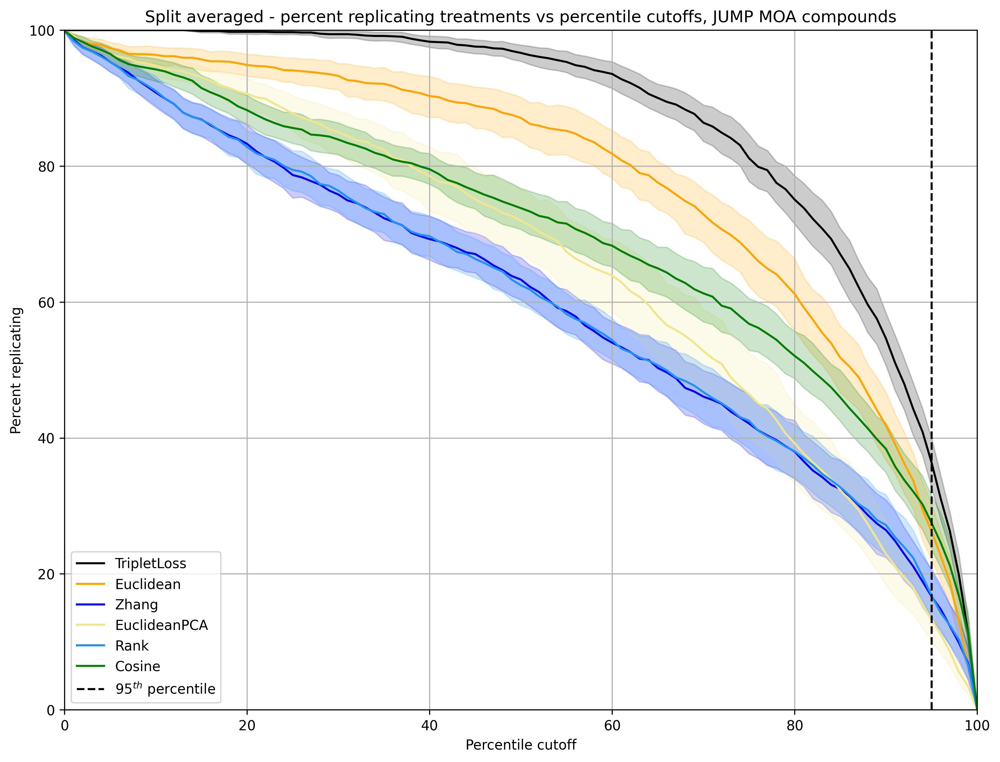

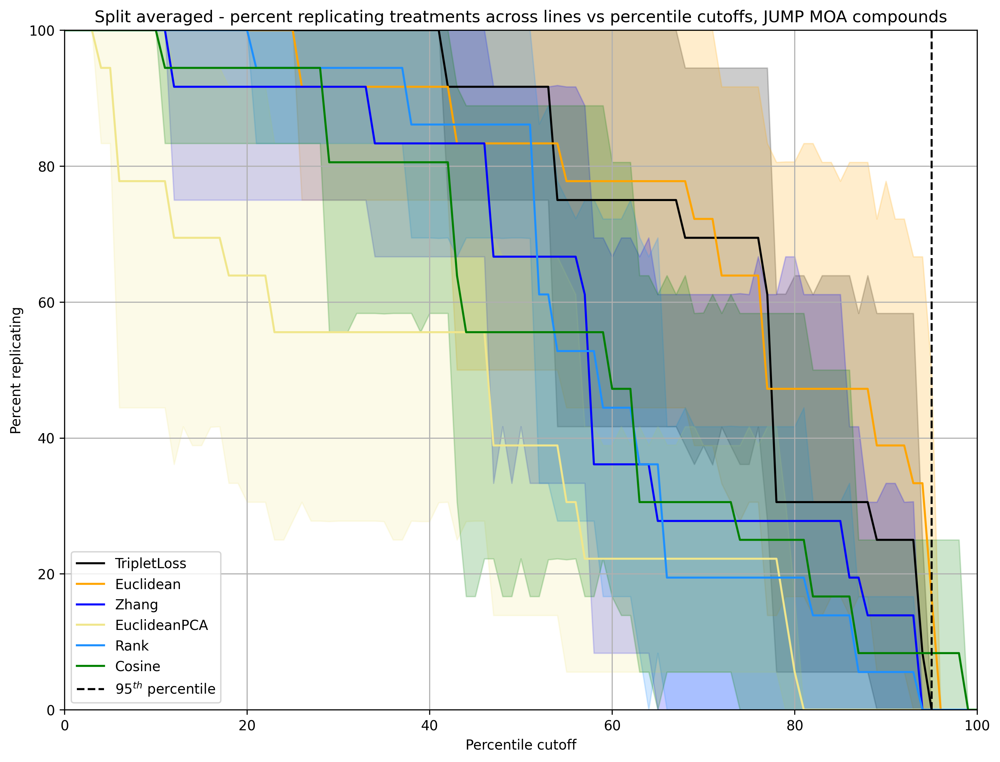

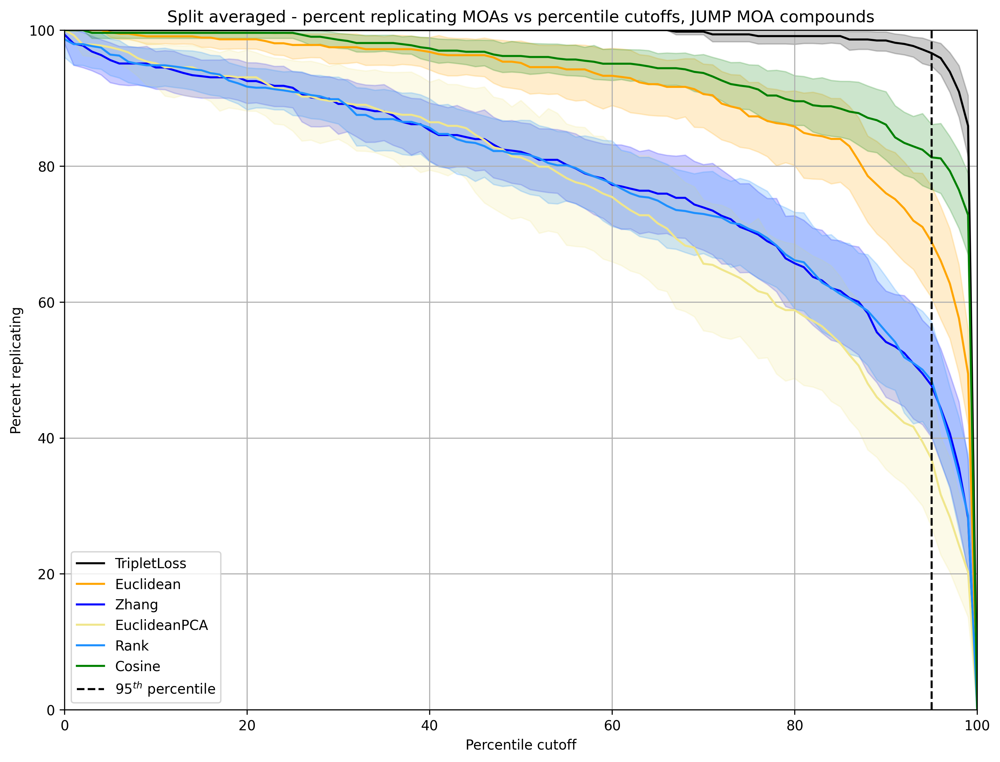

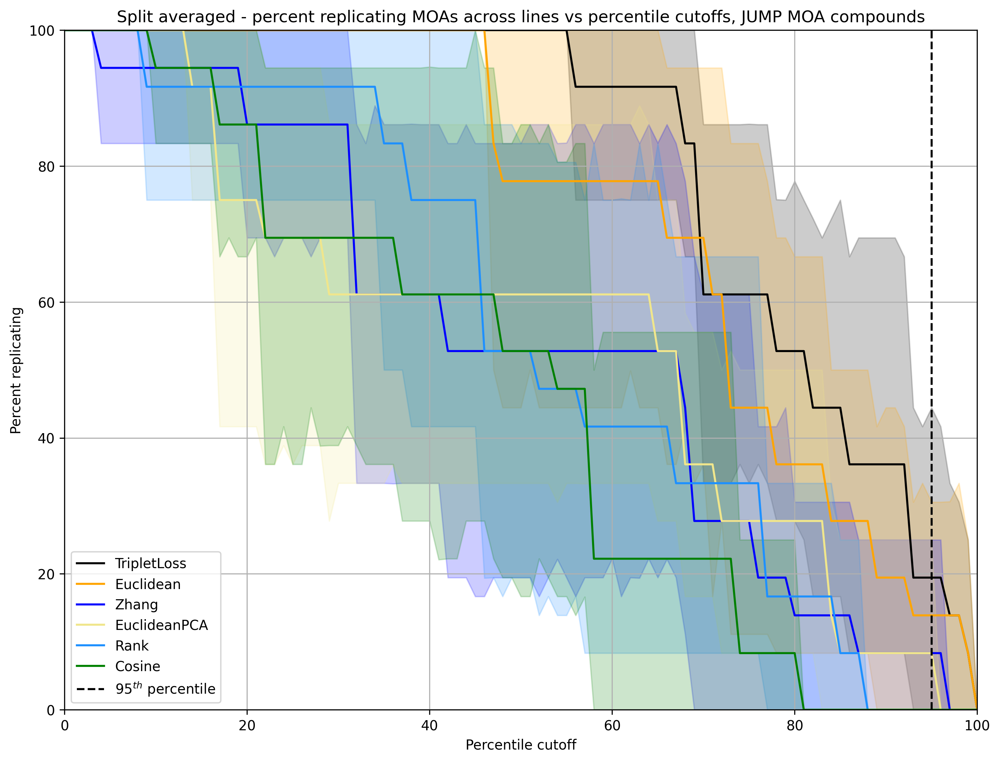

In [15]:
import seaborn as sns
import phenonaut
from pathlib import Path
import numpy as np
from phenonaut.metrics.non_ds_phenotypic_metrics import metrics_with_magic_values
from leakproofcmap.model_to_metric import get_phenonaut_metric_from_model_checkpoint
from leakproofcmap.models.tripletloss import CMAPTripletLossLightningModule
from leakproofcmap.data_wrangling import postprocess_pr_files_unmerged
import pandas as pd
from itertools import combinations
from scipy.stats import kruskal, wilcoxon, false_discovery_control
from matplotlib import pyplot as plt
from leakproofcmap import palette
SEED=7
MODEL_NAME="TripletLoss"
MODEL_IDENTIFIER="155"
CELL_LINE_SPLIT=1
PERTURBATION_SPLIT=1
working_dir=Path("working_dir")
checkpoint_dir=working_dir/Path(MODEL_NAME)/Path("trained")/Path(MODEL_IDENTIFIER)/Path("checkpoints")
metric_display_order_in_tables=['TripletLoss', 'Rank', 'Zhang', 'Cosine', 'Euclidean', 'EuclideanPCA']

metric=get_phenonaut_metric_from_model_checkpoint("TripletLoss", CMAPTripletLossLightningModule,checkpoint_dir/Path(f"cmap_split_cls_{CELL_LINE_SPLIT}_moas_{PERTURBATION_SPLIT}_seed_{SEED}.ckpt"),higher_is_better=False, cuda=True)
all_metrics=dict(**metrics_with_magic_values, **{"TripletLoss":metric})

unmerged_pr_output_dir=(working_dir/Path("plot_data")/Path(MODEL_NAME)/Path(MODEL_IDENTIFIER)/Path("compactnessunmerged"))
if not unmerged_pr_output_dir.exists():
    unmerged_pr_output_dir.mkdir(parents=True, exist_ok=True)
pr_visualisations=[
    {
        'pr_type':'compactness',
        'raw_plot_data':unmerged_pr_output_dir/Path(f"plot_compactnessunmerged_cutoffs_cmap_seed_{SEED}_jumpmoa.csv"),
        'plot_title':f"Split averaged - percent replicating treatments vs percentile cutoffs, JUMP MOA compounds"
    },
    {
        'pr_type':'compactness_across_lines',
        'raw_plot_data':unmerged_pr_output_dir/Path(f"plot_compactnessunmerged_cutoffs_cmap_across_lines_seed_{SEED}_jumpmoa.csv"),
        'plot_title':f"Split averaged - percent replicating treatments across lines vs percentile cutoffs, JUMP MOA compounds"
    },
    {
        'pr_type':'compactness_moas',
        'raw_plot_data':unmerged_pr_output_dir/Path(f"plot_compactnessunmerged_cutoffs_cmap_moas_seed_{SEED}_jumpmoa.csv"),
        'plot_title':f"Split averaged - percent replicating MOAs vs percentile cutoffs, JUMP MOA compounds"
    },
    {
        'pr_type':'compactness_across_lines_moas',
        'raw_plot_data':unmerged_pr_output_dir/Path(f"plot_compactnessunmerged_cutoffs_cmap_across_lines_moas_seed_{SEED}_jumpmoa.csv"),
        'plot_title':f"Split averaged - percent replicating MOAs across lines vs percentile cutoffs, JUMP MOA compounds"
    },
]



for pr_visualisation in pr_visualisations:
    raw_plot_data=pr_visualisation['raw_plot_data']
    if not pr_visualisation['raw_plot_data'].exists():
        postprocess_pr_files_unmerged(seed=7,model_name=MODEL_NAME, model_identifier=MODEL_IDENTIFIER, restrict_pr_type=pr_visualisation['pr_type'],jump_moa_compounds_only = True)
    plot_df=pd.read_csv(pr_visualisation['raw_plot_data'])
    non_merged_pr_file_path=Path(str(pr_visualisation['raw_plot_data'].parents[1]/Path(pr_visualisation['pr_type'])/pr_visualisation['raw_plot_data'].stem.replace("compactnessunmerged_", "compactness_"))+"_95pctl.csv")
    
    fig, ax=plt.subplots(1,figsize=(12,9), dpi=300)
    for rmn in ranked_metric_list:
        sns.lineplot(plot_df.query("`similarity metric` == @rmn"), x="cutoff percentile", y='percent replicating',  hue='similarity metric', ax=ax, sort=False,palette=palette, err_style='band')
    
    ax.grid()
    ax.axvline(95, 0,100, linestyle='--', color='k', label=r'$95^{th}$ percentile')
    ax.set_xlim(0,100)
    ax.set_ylim(0,100)
    ax.set_xlabel("Percentile cutoff")
    ax.set_ylabel("Percent replicating")
    ax.set_title(pr_visualisation['plot_title'])
    ax.legend()
    fig.show()
    method_means={}
    for idx, df in plot_df.query("`cutoff percentile`==95").reset_index()[['similarity metric', 'percent replicating', 'split']].groupby("similarity metric"):
        method_means[idx]=df.sort_values("split")['percent replicating']
    print("kruskal:", kruskal(*list(method_means.values())))
    wilcoxon_pvals=pd.DataFrame()
    for m1 in metric_display_order_in_tables:
        if np.all(method_means[m1]==0):
            continue
        for m2 in metric_display_order_in_tables:
            if np.all(method_means[m2]==0):
                continue
            if m1==m2:
                wilcoxon_pvals.loc[m1, m2]=np.nan
                continue
            delta_m1_m2=method_means[m1].values-method_means[m2].values
            if np.all(delta_m1_m2==0):
                print("All zeros")
                continue
            wilcoxon_pvals.loc[m1, m2]=wilcoxon(delta_m1_m2,None, alternative='greater').pvalue
    display("Wilcoxon test-derived pvalues:")
    wilcoxon_pvals.to_csv(str(pr_visualisation['raw_plot_data']).replace("plot_compactness", "wilcoxon_pvals_"))

    display(wilcoxon_pvals)

    fdr_corrected_pvals=false_discovery_control([p for p in wilcoxon_pvals.values.ravel() if not np.isnan(p)])
    fdr_corrected_pvals_iter=iter(fdr_corrected_pvals)
    for row, col, value in [tuple(x) for x in wilcoxon_pvals.stack().reset_index().values.tolist()]:
        if np.isnan(value):
            continue
        wilcoxon_pvals.loc[row, col]=next(fdr_corrected_pvals_iter)
    wilcoxon_pvals.to_csv(str(pr_visualisation['raw_plot_data']).replace("plot_compactness", "wilcoxonfdrcorrected_pvals_"))
    display("FDR-corrected Wilcoxon test-derived pvalues:")
    display(wilcoxon_pvals)
    
    metric_pr_score_df=plot_df.query("`cutoff percentile`==95").reset_index()[['similarity metric', 'percent replicating']].groupby("similarity metric").agg(["mean", "std"]).loc[metric_display_order_in_tables]
    display("Averaged splits p values")
    display(metric_pr_score_df.round(3))
    metric_pr_score_df.to_csv(str(pr_visualisation['raw_plot_data'].with_suffix(""))+"_95pctl.csv")
    fig.savefig(str(pr_visualisation['raw_plot_data'].with_suffix(""))+"_area.svg",pad_inches=0, bbox_inches='tight', dpi=300)
    fig.savefig(str(pr_visualisation['raw_plot_data'].with_suffix(""))+"_area.png",pad_inches=0, bbox_inches='tight', dpi=300)


## McNemar's test - JUMP MOA COMPOUNDS ONLY

In [16]:
# Apply McNemar's test to evaluate replicating rates
from pathlib import Path
import json
import pandas as pd
from matplotlib import pyplot as plt
from statsmodels.stats.contingency_tables import mcnemar
import numpy as np
SEED=7
MODEL_NAME="TripletLoss"
MODEL_IDENTIFIER="155"
working_dir=Path("working_dir")
checkpoint_dir=working_dir/Path(MODEL_NAME)/Path("trained")/Path(MODEL_IDENTIFIER)/Path("checkpoints")
metric_display_order_in_tables=['TripletLoss', 'Rank', 'Zhang', 'Cosine', 'Euclidean', 'EuclideanPCA']

pr_visualisations=[
    {
        'pr_type':'compactness',
        'raw_plot_data':working_dir/Path("plot_data")/Path(MODEL_NAME)/Path(MODEL_IDENTIFIER)/Path("compactness"),
    },
    {
        'pr_type':'compactness_across_lines',
        'raw_plot_data':working_dir/Path("plot_data")/Path(MODEL_NAME)/Path(MODEL_IDENTIFIER)/Path("compactness_across_lines"),
    },
    {
        'pr_type':'compactness_moas',
        'raw_plot_data':working_dir/Path("plot_data")/Path(MODEL_NAME)/Path(MODEL_IDENTIFIER)/Path("compactness_moas"),
    },
    {
        'pr_type':'compactness_across_lines_moas',
        'raw_plot_data':working_dir/Path("plot_data")/Path(MODEL_NAME)/Path(MODEL_IDENTIFIER)/Path("compactness_across_lines_moas"),
    },
]

for pr_visualisation in pr_visualisations:
    perf_df=pd.DataFrame()
    metrics=set([f.stem.split("_")[1] for f in pr_visualisation['raw_plot_data'].glob(f"pr_*_cls*_ps*_seed_{SEED}_jumpmoa.csv")])
    for metric in metrics:
        re_non_rep_dict=pd.concat([pd.read_csv(f, usecols=['is_replicating']) for f in [fnojump for fnojump in pr_visualisation['raw_plot_data'].glob(f"pr_{metric}_*cls*_ps*_seed_{SEED}_jumpmoa.csv")]]).value_counts().to_dict()
        if (1,) not in re_non_rep_dict:
            re_non_rep_dict[(1,)]=0
        perf_df.loc[metric, ['replicating', 'non_replicating']]=re_non_rep_dict[(1,)],re_non_rep_dict[(0,)]
    perf_df=perf_df.sort_values("replicating", ascending=False)
    perf_df['Percent replicating']=(perf_df['replicating']/(perf_df['replicating']+perf_df['non_replicating']))*100

    best_scoring_metric, second_best_scoring_metric=perf_df.index[0:2].tolist()
    print(f"Testing top 2 ({best_scoring_metric} & {second_best_scoring_metric}) using Mcnemar's test")

    rank_1_df=pd.concat([pd.read_csv(f, index_col=0, usecols=['Unnamed: 0', 'is_replicating']) for f in pr_visualisation['raw_plot_data'].glob(f"pr_{best_scoring_metric}_*cls*_ps*_seed_{SEED}_jumpmoa.csv")])
    rank_2_df=pd.concat([pd.read_csv(f, index_col=0, usecols=['Unnamed: 0', 'is_replicating']) for f in pr_visualisation['raw_plot_data'].glob(f"pr_{second_best_scoring_metric}_*cls*_ps*_seed_{SEED}_jumpmoa.csv")])
    merged_df=rank_1_df.merge(rank_2_df, left_index=True, right_index=True,suffixes=(f"_{best_scoring_metric}", f"_{second_best_scoring_metric}"))
    contingency_table=np.array([
        [np.sum((merged_df[f'is_replicating_{best_scoring_metric}']==1) & (merged_df[f'is_replicating_{second_best_scoring_metric}']==1)),np.sum((merged_df[f'is_replicating_{best_scoring_metric}']==1) & (merged_df[f'is_replicating_{second_best_scoring_metric}']==0))],
        [np.sum((merged_df[f'is_replicating_{best_scoring_metric}']==0) & (merged_df[f'is_replicating_{second_best_scoring_metric}']==1)),np.sum((merged_df[f'is_replicating_{best_scoring_metric}']==0) & (merged_df[f'is_replicating_{second_best_scoring_metric}']==0))],
    ])
    mcnemar_results=mcnemar(contingency_table)
    print(mcnemar_results)
    json.dump({'contingency_table':contingency_table.tolist(), 'mcnemar_results':{'pvalue':float(mcnemar_results.pvalue), 'statistic':float(mcnemar_results.pvalue)}}, open(pr_visualisation['raw_plot_data']/"mcnemar_pvalues_jumpmoa.json", 'w'))


Testing top 2 (TripletLoss & Cosine) using Mcnemar's test
pvalue      9.161841381342016e-10
statistic   175.0
Testing top 2 (Euclidean & Cosine) using Mcnemar's test
pvalue      1.0
statistic   2.0
Testing top 2 (TripletLoss & Cosine) using Mcnemar's test
pvalue      1.6502251632246126e-15
statistic   4.0
Testing top 2 (TripletLoss & Euclidean) using Mcnemar's test
pvalue      0.2890625
statistic   2.0
